## Longevity Bayes Net


First we create a Pomegranate Bayesian Network using the protobuf interface and our utility package, bayesnet, that enables one to conveniently create a Bayesian network by hand, and in accord with common statistics and rules, without having to fill in every probability.  The same Baysian network can start with our hand entered rules, but can later learn from data.  Any amount of questions can be answered, including no questions, to get the probabilities .  The file the Bayesian net is written in is longevity_bayes.py.  Our utility package can then be used to query the network with different evidence of states.  This is convenient for tuning hand entered parameters .



In [1]:
import sys
!{sys.executable} -m pip install --upgrade pip
!{sys.executable} -m pip install -e ../bayesnet
!{sys.executable} -m pip install matplotlib
!{sys.executable} -m pip install networkx
!{sys.executable} -m pip install graphviz
!{sys.executable} -m pip install datetime
!{sys.executable} -m pip install grpcio
!{sys.executable} -m pip install --no-cache-dir --upgrade numpy
!{sys.executable} -m pip install pomegranate==0.14.0
!{sys.executable} -m pip install qpsolvers
!{sys.executable} -m pip install osqp





Obtaining file:///home/opencog/bayesnet
  Preparing metadata (setup.py) ... done
  Attempting uninstall: covid-bayes
    Found existing installation: covid-bayes 1.0
    Can't uninstall 'covid-bayes'. No files were found to uninstall.
  Running setup.py develop for covid-bayes


In [2]:
!{sys.executable} -m pip install -r requirements.txt
!sh buildproto.sh

### Longevity net
Here put the name of the network you have written with the protobuf and bayes utilities.  Our example is printed out.  We created 4 functions in our utility package: any_of, all_of, if_the_else, and avg, which can together be used to express almost any set of rules, documented elsewhere.  We also implemented a dependency rule with which one can enter statistics from Systematic Reviews and Meta analyses easily.  The last lines implement the creation of the description of the network,  bayesianNetwork , with the protobuf utilities, and then the creation of the Pomegranate network with the description.  

In [3]:
text_file = open('./sn_bayes/longevity_bayes.py')
#text_file = open('./sn_bayes/longevity_bayes_short.py')
file_content = text_file.read()
print(file_content)
text_file.close()

import sn_bayes
from sn_bayes.utils import any_of
from sn_bayes.utils import all_of
from sn_bayes.utils import avg
from sn_bayes.utils import if_then_else
from sn_bayes.utils import bayesInitialize
from sn_bayes.utils import addCpt
from sn_bayes.utils import dependency
from sn_bayes.utils import non_cpt_descriptions

import sn_service.service_spec.bayesian_pb2
from sn_service.service_spec.bayesian_pb2 import BayesianNetwork


def longevity_bayes():
        bayesianNetwork = BayesianNetwork()
        cpt = {}
        outstr = '' 
                
        #probabilities within distributions must sum to 1.0
    #questions left blank or "prefer not to answer" will be computed

    #anomalies
        
                # increasing variability in step is associated with 
                # loss of resiliance , the root of aging
                # https://www.nature.com/articles/s41467-021-23014-1
                
                #variablility of number of steps within a day

        anomaly = b

 Next run the file and print the rules in it in human readable format.  All routines are stateless.

## Timing:  compiling, computation, explaning
Below you see that it takes about 1 hour and 16 minutes to compile the file.  However, the user does not experience this delay, just the programmer.  Later this notebook you will see that the computation time, to get to the answer when it is running, is about 7 seconds.  Times to get an explanation depend on how many possible explanations we want to cover: for example, if there are 60 things to check, it takes 16 seconds.  We have made a way to retrieve the answers gradually over that time, if necessary.

In [4]:
import qpsolvers
print(qpsolvers.available_solvers)


['osqp', 'quadprog']


In [5]:
import pickle
from os.path import exists
import sn_bayes
from sn_bayes import longevity_bayes

if exists("bayesianNetwork.pkl"):
        infile = open("bayesianNetwork.pkl",'rb')
        bayesianNetwork = pickle.load(infile)
        infile.close()
else:
        %time bayesianNetwork,outstr = longevity_bayes.longevity_bayes()
        print (outstr)
        outfile = open("bayesianNetwork.pkl",'wb')
        pickle.dump(bayesianNetwork,outfile)
        outfile.close()
 


For convenience of creating a table, here are all the variables in the net in order.  They should be mapped into the individual buckets of the rules.  

In [6]:
import sn_bayes
from sn_bayes.utils import complexity_check
complexity_check(bayesianNetwork)

(True, '')

In [7]:
import sn_bayes
from sn_bayes.utils import get_var_positions
var_positions = get_var_positions(bayesianNetwork)
var_positions

{'age': 0,
 'daily_aspirin_compliance': 1,
 'high_blood_pressure_patient_prescription': 2,
 'high_blood_pressure_medication_compliance': 3,
 'diastolic': 4,
 'systolic': 5,
 'sun_exposure_half_hour': 6,
 'time_spent_outdoors': 7,
 'sun_exposure_use_sunscreen': 8,
 'sunburn_last_year': 9,
 'weight_at_25': 10,
 'bmi': 11,
 'dietary_energy': 12,
 'shortness_of_breath_exertion': 13,
 'daily_walk_or_bicycle_travel': 14,
 'daily_time_sitting': 15,
 'physical_work': 16,
 'ten_minutes_daily_workout': 17,
 'heart_rate_anomaly': 18,
 'steps_anomaly': 19,
 'workout_anomaly': 20,
 'walking_speed_anomaly': 21,
 'walking_speed_variability_anomaly': 22,
 'stride_variability_anomaly': 23,
 'step_asymmetry_anomaly': 24,
 'double_support_stepping_anomaly': 25,
 'step_variability_anomaly': 26,
 'cumin_supplementation': 27,
 'anxious_how_often': 28,
 'marital_status': 29,
 'birth_weight': 30,
 'asthma_attack_last_year': 31,
 'liver_condition': 32,
 'fatiqued_in_2_weeks': 33,
 'osteoporosis': 34,
 'artific

Here are the positions of every bucketed response for each of the above variables:

In [8]:
import sn_bayes
from sn_bayes.utils import get_var_val_positions
var_val_positions = get_var_val_positions(bayesianNetwork)
var_val_positions

{'age': {'elderly': 0, 'adult': 1, 'young_adult': 2, 'teen': 3, 'child': 4},
 'daily_aspirin_compliance': {'daily_aspirin_compliance_no': 0,
  'daily_aspirin_compliance_yes': 1},
 'high_blood_pressure_patient_prescription': {'high_blood_pressure_patient_prescription_yes': 0,
  'high_blood_pressure_patient_prescription_no': 1},
 'high_blood_pressure_medication_compliance': {'high_blood_pressure_medication_compliance_no': 0,
  'high_blood_pressure_medication_compliance_yes': 1},
 'diastolic': {'diastolic_120_or_higher_crisis': 0,
  'diastolic_90_to_119_high_stage_2': 1,
  'diastolic_80_to_89_high_stage_1': 2,
  'diastolic_less_than_80_normal': 3},
 'systolic': {'systolic_180_over_crisis': 0,
  'systolic_140_to_179_high_stage_2': 1,
  'systolic_130_to_139_high_stage_1': 2,
  'systolic_120_to_129_elevated': 3,
  'systolic_less_than_120_normal': 4},
 'sun_exposure_half_hour': {'sun_exposure_half_hour_severe_sunburn_blisters': 0,
  'sun_exposure_half_hour_severe_sunburn_peeling': 1,
  'sun_e

We create a spreadsheet of the above for reference

In [9]:
import pandas as pd

rows_list = []
outname = "varvals.csv"
for var, valdict in var_val_positions.items():
    rowdict = {} 
    rows_list.append(rowdict)
    varstr= var +"("
    for val, pos in valdict.items():
        varstr += val
        varstr+= ","
            
    varstr=varstr[:-1]+")"
    rowdict["variable"] = varstr        

df = pd.DataFrame(rows_list)      
df.to_csv(outname, index = False)

## Variables to connect to , in order to fill in the health recommendations

diet:  "poor_diet".  upshot will not include socioeconomic status in recommendations and will recommend to increase or decrease things in diet, including calories


supplements:  "poor_diet_flag".  This shows area of deficiency that may need supplementation over and above diet


sleep hygiene:  "poor_sleep"


body weight: "obesity"


exercise: "lack_of_exercise"


lifestyle:   - "poor_diet_quantity"(water caffine sodium alcohol) + "psychological_disorders"(anxiety and marital status) + "smoking".  Just add to each other, do not rank with the same numbers to each.

## Variables to conect to, in order to fill in the hallmarks

"hallmark_1_genomic_instability"

"hallmark_2_telomere_attrition"

"hallmark_3_epigenetic_alterations"

"hallmark_4_loss_of_proteostasis"

"hallmark_5_deregulated_nutrient_sensing"

"hallmark_6_mitochondrial_dysfunction"

"hallmark_7_cellular_senescence"

"hallmark_8_stem_cell_exhaustion"

"hallmark_9_altered_intercellular_communication"

"hallmark_10_extracellular_matrix_dysfunction"
       

Here we create a spreadsheet that makes a Cartesian product of desired outputs with the remainder of the variables. This can be used to, for example, fill in a treatment recommendation for variables that are returned as causing the output in the explanation module 

In [10]:
import pandas as pd



#cols = ["leaves","internal","output"]
desired_output =["hallmark_1_genomic_instability","hallmark_2_telomere_attrition","hallmark_3_epigenetic_alterations",
"hallmark_4_loss_of_proteostasis","hallmark_5_deregulated_nutrient_sensing","hallmark_6_mitochondrial_dysfunction",
"hallmark_7_cellular_senescence","hallmark_8_stem_cell_exhaustion","hallmark_9_altered_intercellular_communication",
"hallmark_10_extracellular_matrix_dysfunction","poor_diet","poor_diet_flag","poor_sleep","psychological_disorders",
"obesity","lack_of_exercise","poor_diet_quantity","smoking"]

rows_list = []
outname = "upshot.csv"

#put leaves in the first column, then internal vars along with the vars that feed them in the second.  
#and do a cartesian product with the outvars that are also internal vars (should be all of them)

for output in desired_output:
    for dist in bayesianNetwork.discreteDistributions:
        print(dist.name)
        rowdict = {} 
        rowdict["leaves"]= dist.name
        rowdict["internal"]=""
        rowdict["output"]= output
        rows_list.append(rowdict)
    for table in bayesianNetwork.conditionalProbabilityTables:
        print ("table: {}".format(table.name))
        rowdict = {}
        rowdict["leaves"]=""
        internal_str = table.name + " ("
        for var in table.randomVariables:
            print(var.name)
            internal_str += var.name
            internal_str+= ","         
        internal_str=internal_str[:-1]+")"
        rowdict["internal"] = internal_str
        rowdict["output"]= output
        rows_list.append(rowdict)

for dist in bayesianNetwork.discreteDistributions:
    print(dist.name)
    rowdict = {} 
    rowdict["leaves"]= dist.name
    rowdict["internal"]=""
    rowdict["output"]= ""
    rows_list.append(rowdict)
for table in bayesianNetwork.conditionalProbabilityTables:
    print ("table: {}".format(table.name))
    rowdict = {}
    rowdict["leaves"]=""
    internal_str = table.name + " ("
    for var in table.randomVariables:
        print(var.name)
        internal_str += var.name
        internal_str+= ","         
    internal_str=internal_str[:-1]+")"
    rowdict["internal"] = internal_str
    rowdict["output"]= ""
    rows_list.append(rowdict)
    
df = pd.DataFrame(rows_list)      
df.to_csv(outname, index = False)

age
daily_aspirin_compliance
high_blood_pressure_patient_prescription
high_blood_pressure_medication_compliance
diastolic
systolic
sun_exposure_half_hour
time_spent_outdoors
sun_exposure_use_sunscreen
sunburn_last_year
weight_at_25
bmi
dietary_energy
shortness_of_breath_exertion
daily_walk_or_bicycle_travel
daily_time_sitting
physical_work
ten_minutes_daily_workout
heart_rate_anomaly
steps_anomaly
workout_anomaly
walking_speed_anomaly
walking_speed_variability_anomaly
stride_variability_anomaly
step_asymmetry_anomaly
double_support_stepping_anomaly
step_variability_anomaly
cumin_supplementation
anxious_how_often
marital_status
birth_weight
asthma_attack_last_year
liver_condition
fatiqued_in_2_weeks
osteoporosis
artificial_joints
lymphocite_number
mchc
nucleated_red_blood_cells
blood_urea_nitrogen
chloride
globulin
bilirubin
total_protein
toxins_in_blood
segmented_neutrophils
cadmium
cobalt
chromium
mercury
manganese
lead
selenium
cotinine
eosinophils_percent
ferritin
hemoglobin
serum_i

dietary_sodium
alcohol_consumption_last_year
num_alcoholic_drinks_when_drinking
table: diet_quality_food
how_healthy_diet
eat_out_how_many_times_per_week
diet_fats
diet_vitamins_and_minerals
table: diet_quantity
diet_substances
diet_supplements
diet_basics
table: diet_quality
diet_quantity
diet_quality_food
table: poor_diet
low_socioeconomic_status
diet_quality
poor_diet_flag
table: inflammation_from_diet
omega_3
poor_diet
blood_metabolism_disorder_indicators
dietary_carbohydrate
water_drank_yesterday
table: inflammation
c_reactive_protein
inflammation_from_behavior
inflammation_from_diet
age
table: hypertension_from_behavior
daily_time_sitting
workday_sleep_hours_per_night
dietary_sodium
inflammation
table: hypertension
hypertension_from_behavior
c_reactive_protein
dna_methylation
reported_hypertension
age
table: kidney_disease
blood_kidney_disorder_indicators
hypertension
obesity
table: psychological_disorders
anxious_how_often
marital_status
inflammation
heart_rate_variability_anoma

dietary_riboflavin
dietary_b12
table: poor_diet_vitamin_b
poor_diet_vitamin_b_1
poor_diet_vitamin_b_2
table: poor_diet_vitamin_other
dietary_vitamin_C
dietary_alpha_tocopherol
dietary_calcium
table: poor_diet_vitamins_and_minerals
poor_diet_minerals
poor_diet_vitamin_a
poor_diet_vitamin_b
poor_diet_vitamin_other
vitamin_and_mineral_labs
table: omega_3
fish_last_month
tuna_eaten_times_per_month
dietary_epa
dietary_pfa
table: poor_diet_fats
omega_3
dietary_fat
dietary_cholesterol
table: poor_diet_basics
water_drank_yesterday
dietary_fiber
dietary_carbohydrate
dietary_energy
table: poor_diet_supplements
dietary_lycopene
dietary_lutein
dietary_selenium
dietary_choline
table: poor_diet_substances
dietary_caffeine
dietary_sodium
alcohol_consumption_last_year
num_alcoholic_drinks_when_drinking
table: poor_diet_quantity
poor_diet_substances
poor_diet_supplements
poor_diet_basics
table: poor_diet_food
poor_diet_fats
poor_diet_vitamins_and_minerals
table: poor_diet_flag
poor_diet_quantity
poor_d

ten_minutes_daily_workout
coq10_supplementation
table: tnf_alpha
ten_minutes_daily_workout
coq10_supplementation
table: fasting_glucose
ginger_supplementation
glucose_serum
table: lung_disease
soy_isoflavones_supplementation
daily_plant_protein_servings
micro_nucleus_frequency
table: a1c
micro_nucleus_frequency
nigella_sativa_supplementation
ginger_supplementation
dna_methylation
fasting_glucose
table: heart_rate_variability_anomaly
heart_rate_anomaly
table: oxygen_anomaly
obesity
heart_rate_anomaly
table: sleep_anomaly
lack_of_exercise
oxygen_anomaly
table: blood_illness_indicators
nucleated_red_blood_cells
globulin
white_blood_cell_count
table: blood_metabolism_disorder_indicators
total_cholesterol
triglycerides
a1c
direct_HDL
table: reported_heart_symptoms
daily_asprin_prescription
daily_aspirin_compliance
angina
chest_pain
blood_relative_heart_attack_before_age_50
table: blood_heart_disorder_indicators
creatine_phosphokinase
sodium
chloride
table: resting_heart_rate
heart_rate_anom

triglycerides
uric_acid
benzonitrile
vitamin_C
white_blood_cell_count
albumin_creatinine_ratio
volitile_organic_compound
work_limiting_problem
ten_stairs_difficulty
chore_difficulty
walking_difficulty
stand_from_sit_difficulty
two_hour_standing_difficulty
two_hour_sitting_difficulty
social_activity_difficulty
urine_leakage_bother
hearing_difficulty_how_often
hearing_frustration_how_often
wear_hearing_aid
loud_noise_job
loud_music
average_oxygen_saturation
garlic_supplementation
nigella_sativa_supplementation
coq10_supplementation
spirulina_supplementation
ginger_supplementation
soy_isoflavones_supplementation
dietary_folate
folate
folate_mefox
second_hand_smoke
five_days_smoke_cigarettes
ever_vaped
gender
work_schedule
weekend_sleep_hours_per_night
fish_last_month
tuna_eaten_times_per_month
eat_out_how_many_times_per_week
how_healthy_diet
dietary_alpha_carotene
dietary_alpha_tocopherol
dietary_beta_carotene
dietary_caffeine
dietary_calcium
dietary_carbohydrate
dietary_choline
dietary_c

table: hallmark_2_telomere_attrition
smoking
gender
table: age_related_macular_degeneration
hallmark_2_telomere_attrition
table: diabetes_from_behavior
dietary_caffeine
daily_time_sitting
workday_sleep_hours_per_night
bmi
table: diabetes
diabetes_from_behavior
a1c
age
hypertension
table: hallmark_6_mitochondrial_dysfunction
inflammation
table: cardiovascular_disease_from_behavior
age
obesity
workday_sleep_hours_per_night
table: cardiovascular_disease
cardiovascular_disease_from_behavior
micro_nucleus_frequency
heart_disorder_indicators
diabetes
hypertension
table: metabolic_disease
cardiovascular_disease
diabetes
hypertension
table: lung_or_kidney_or_liver_disease
lung_disease
kidney_disease
liver_disorders
table: chronic_conditions
lung_or_kidney_or_liver_disease
immunocompromised
psychological_disorders
table: comorbidities
chronic_conditions
metabolic_disease
obesity
table: frailty_measures
inactivated_sirtuins
micro_nucleus_frequency
hallmark_2_telomere_attrition
frailty_signs
tabl

In [11]:
df

,leaves,internal,output
0,age,,hallmark_1_genomic_instability
1,daily_aspirin_compliance,,hallmark_1_genomic_instability
2,high_blood_pressure_patient_prescription,,hallmark_1_genomic_instability
3,high_blood_pressure_medication_compliance,,hallmark_1_genomic_instability
4,diastolic,,hallmark_1_genomic_instability
...,...,...,...
5942,,hallmark_5_deregulated_nutrient_sensing (frailty),
5943,,"hallmark_8_stem_cell_exhaustion (frailty,infla...",
5944,,hallmark_9_altered_intercellular_communication...,
5945,,hallmark_10_extracellular_matrix_dysfunction (...,


Here is a one more csv that uses a utility function to express the net in  a tree form, in a data frame and then prints it out 

In [12]:
import sn_bayes
from sn_bayes.utils import make_tree
import pandas as pd
df = make_tree(bayesianNetwork)
outname = "tree.csv"
df.to_csv(outname, index = False)

In [13]:
df

,level0,level1,level2,level3,level4,level5,level6,level7,level8,level9,...,level12,level13,level14,level15,level16,level17,level18,level19,level20,level21
0,age),angina(age),daily_asprin_prescription(angina),"lack_of_exercise(lack_of_exercise_signal,lack_...","obesity_factors(daily_time_sitting,workday_sle...","obesity(bmi,obesity_factors)","oxygen_anomaly(obesity,heart_rate_anomaly)","sleep_anomaly(lack_of_exercise,oxygen_anomaly)","poor_sleep(poor_sleep_schedule,sleep_anomaly)","inflammation_from_behavior(uv_exposure,poor_or...",...,"hypertension(hypertension_from_behavior,c_reac...",kidney_disease(blood_kidney_disorder_indicator...,cardiovascular_disease(cardiovascular_disease_...,"metabolic_disease(cardiovascular_disease,diabe...","comorbidities(chronic_conditions,metabolic_dis...","frailty(how_healthy_diet,frailty_measures,como...",hallmark_3_epigenetic_alterations(liver_disord...,"cancer(cancer_from_behavior,micro_nucleus_freq...","hallmark_7_cellular_senescence(cancer,inflamma...",mitochondrial_dysfunction_or_cellular_senescen...
1,daily_aspirin_compliance),greatest_weight(weight_at_25),blood_relative_heart_attack_before_age_50(angina),"teeth_health(times_brush_teeth_daily,floss_day...","mouth_pain_last_year(gum_disease,teeth_health)",signal_heart_disorder_indicators(resting_heart...,heart_disorder_indicators(blood_heart_disorder...,"c_reactive_protein(ten_minutes_daily_workout,n...","frailty_measures(inactivated_sirtuins,micro_nu...",None,...,age_acceleration_from_behavior(psychological_d...,age_acceleration(age_acceleration_from_nutriti...,"lung_or_kidney_or_liver_disease(lung_disease,k...",chronic_conditions(lung_or_kidney_or_liver_dis...,alzheimers_disease(hallmark_2_telomere_attriti...,None,hallmark_5_deregulated_nutrient_sensing(frailty),None,hallmark_9_altered_intercellular_communication...,None
2,high_blood_pressure_patient_prescription),height(bmi),chest_pain(angina),"gum_disease(times_brush_teeth_daily,floss_days...",blood_metabolism_disorder_indicators(total_cho...,"poor_oral_health(teeth_health,gum_disease,flos...",inflammation_from_illness(blood_illness_indica...,"inflammation_from_diet(omega_3,poor_diet,blood...",None,None,...,None,"diabetes(diabetes_from_behavior,a1c,age,hypert...",None,hallmark_4_loss_of_proteostasis(cardiovascular...,parkinsons_disease(hallmark_2_telomere_attriti...,None,"hallmark_8_stem_cell_exhaustion(frailty,inflam...",None,hallmark_10_extracellular_matrix_dysfunction(c...,None
3,high_blood_pressure_medication_compliance),hip(bmi),"weight(greatest_weight,bmi)","cognitive_impairment(micro_nucleus_frequency,w...","resting_heart_rate(heart_rate_anomaly,lack_of_...","poor_diet_flag(poor_diet_quantity,poor_diet_food)","poor_diet(low_socioeconomic_status,diet_qualit...","frailty_signs(general_aging_signs,sarcopenia,b...",None,None,...,None,None,None,None,None,None,None,None,None,None
4,diastolic),lack_of_workout_reported(daily_walk_or_bicycle...,waist(hip),"lung_disease(soy_isoflavones_supplementation,d...","poor_diet_quantity(poor_diet_substances,poor_d...","diet_quality(diet_quantity,diet_quality_food)","sarcopenia(age,sarcopenia_reported,frailty_sig...",hallmark_1_genomic_instability(blood_age_indic...,None,None,...,None,None,None,None,None,None,None,None,None,None
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
156,weekly_nut_servings),None,None,None,None,None,None,None,None,None,...,None,None,None,None,None,None,None,None,None,None
157,weekly_fish_servings),None,None,None,None,None,None,None,None,None,...,None,None,None,None,None,None,None,None,None,None
158,weekly_processed_meat_servings),None,None,None,None,None,None,None,None,None,...,None,None,None,None,None,None,None,None,None,None
159,daily_plant_protein_servings),None,None,None,None,None,None,None,None,None,...,None,None,None,None,None,None,None,None,None,None


In [14]:
import networkx as nx
import re

G = nx.DiGraph()
regex = re.compile(r'^([a-z_]*)\(.*')


for index, row in df.iterrows():
    for col in df.columns:
        if row[col] is not None:
            node = row[col][:-1] if col == "level0" else row[col]
            G.add_node(node)
            
for node1 in G.nodes:
    for node2 in G.nodes:
        match = regex.match(node1)
        if (node1+',' in node2) or (match is not None and match.group(1)+"," in node2): 
            G.add_edge(node1,node2)
            if match is not None and match.group(1)+"," in node2:
                print (node1)
                print(node2)
        

angina(age)
reported_heart_symptoms(daily_asprin_prescription,daily_aspirin_compliance,angina,chest_pain,blood_relative_heart_attack_before_age_50)
daily_asprin_prescription(angina)
reported_heart_symptoms(daily_asprin_prescription,daily_aspirin_compliance,angina,chest_pain,blood_relative_heart_attack_before_age_50)
lack_of_exercise(lack_of_exercise_signal,lack_of_exercise_reported)
sleep_anomaly(lack_of_exercise,oxygen_anomaly)
obesity(bmi,obesity_factors)
oxygen_anomaly(obesity,heart_rate_anomaly)
obesity(bmi,obesity_factors)
inflammation_from_illness(blood_illness_indicators,obesity,asthma_attack_last_year,fatiqued_in_2_weeks)
obesity(bmi,obesity_factors)
cardiovascular_disease_from_behavior(age,obesity,workday_sleep_hours_per_night)
poor_sleep(poor_sleep_schedule,sleep_anomaly)
inflammation_from_behavior(uv_exposure,poor_oral_health,toxin_labs,poor_sleep,lack_of_exercise)
poor_sleep(poor_sleep_schedule,sleep_anomaly)
hallmark_3_epigenetic_alterations(liver_disorders,poor_sleep,fola

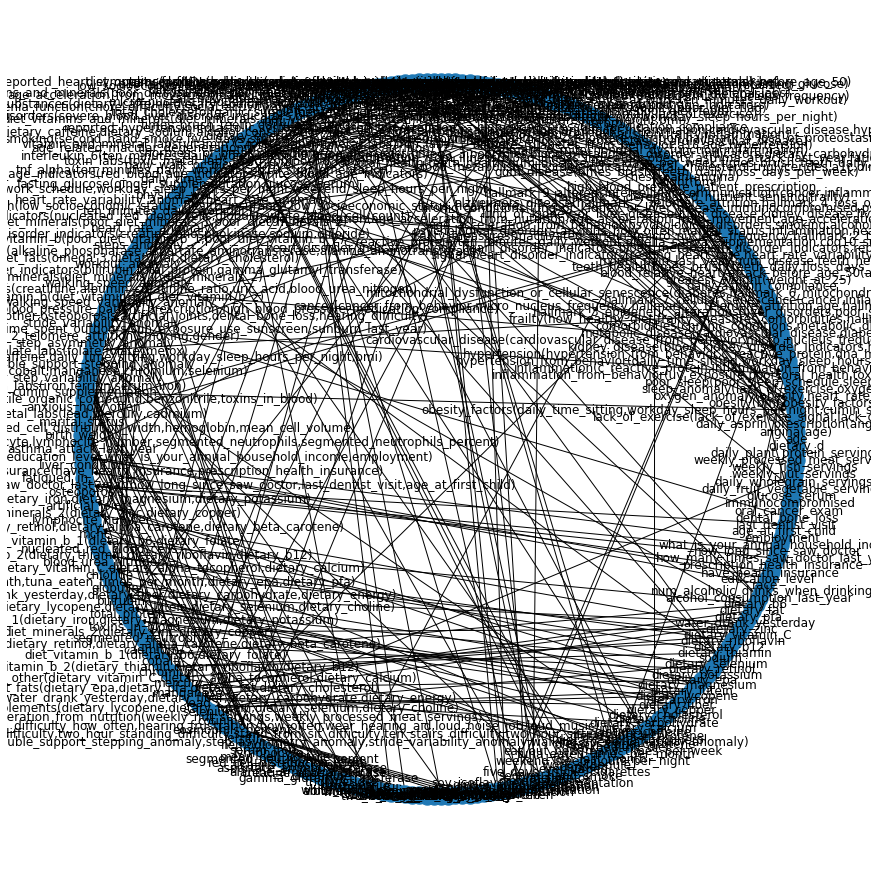

In [15]:
import matplotlib.pyplot as plt
plt.figure(3,figsize=(12,12)) 
#nx.draw(G, with_labels=True)  
#nx.draw_random(G, with_labels=True)   
nx.draw_circular(G, with_labels=True)  
#nx.draw_spectral(G, with_labels=True)   
#nx.draw_spring(G, with_labels=True)  

Here is the description of the Bayesian network in protobuf that we just created with the running of the python file.  The "leaves" have initial probabilities (DiscreteDistribution), and the conditional probabilities (ConditionalProbabilityTable) are to be computed:

In [16]:
bayesianNetwork

discreteDistributions {
  name: "age"
  variables {
    name: "elderly"
    probability: 0.05000000074505806
  }
  variables {
    name: "adult"
    probability: 0.25
  }
  variables {
    name: "young_adult"
    probability: 0.30000001192092896
  }
  variables {
    name: "teen"
    probability: 0.20000000298023224
  }
  variables {
    name: "child"
    probability: 0.20000000298023224
  }
}
discreteDistributions {
  name: "daily_aspirin_compliance"
  variables {
    name: "daily_aspirin_compliance_no"
    probability: 0.30000001192092896
  }
  variables {
    name: "daily_aspirin_compliance_yes"
    probability: 0.699999988079071
  }
}
discreteDistributions {
  name: "high_blood_pressure_patient_prescription"
  variables {
    name: "high_blood_pressure_patient_prescription_yes"
    probability: 0.15000000596046448
  }
  variables {
    name: "high_blood_pressure_patient_prescription_no"
    probability: 0.8500000238418579
  }
}
discreteDistributions {
  name: "high_blood_pressure_m

Here is the Pomegranate net we just made with the description.  Here we compile the net so we can compute probabilities with it.

In [17]:
from sn_bayes.utils import bayesInitialize
longevity = bayesInitialize(bayesianNetwork)

In [18]:
longevity.bake()

We we call a Pomegranate routine that shows the computed probabilities of every variable.  We have made our own utility that pulls out particular variables.

In [19]:
longevity.predict_proba({}) 

array([{
    "class" : "Distribution",
    "dtype" : "str",
    "name" : "DiscreteDistribution",
    "parameters" : [
        {
            "elderly" : 0.049997859213112346,
            "adult" : 0.2499970595220667,
            "young_adult" : 0.3000044376090262,
            "teen" : 0.20000031841007587,
            "child" : 0.20000032524571895
        }
    ],
    "frozen" : false
},
       {
    "class" : "Distribution",
    "dtype" : "str",
    "name" : "DiscreteDistribution",
    "parameters" : [
        {
            "daily_aspirin_compliance_no" : 0.30000001515876124,
            "daily_aspirin_compliance_yes" : 0.6999999848412388
        }
    ],
    "frozen" : false
},
       {
    "class" : "Distribution",
    "dtype" : "str",
    "name" : "DiscreteDistribution",
    "parameters" : [
        {
            "high_blood_pressure_patient_prescription_yes" : 0.1499988165459595,
            "high_blood_pressure_patient_prescription_no" : 0.8500011834540404
        }
    ],
    "fro

## Testing the Bayesian Network

Here we use our query util to enter patient states as evidence (evidence), and then see the probabilities of particular variables we are interested in (outvars), in this case, the output variables.    The query function needs the compiled Pomegranate Bayesian network as well as the description of the network.  In the following examples, we enter a particular patients state , one question at a time, to get a continual change in probability of all states.Adding more risk factors increases risk more.  

In [20]:
import sn_bayes
from sn_bayes.utils import query
evidence = {}
outvars = ["hallmark_1_genomic_instability","hallmark_2_telomere_attrition","hallmark_3_epigenetic_alterations",
"hallmark_4_loss_of_proteostasis","hallmark_5_deregulated_nutrient_sensing","hallmark_6_mitochondrial_dysfunction",
"hallmark_7_cellular_senescence","hallmark_8_stem_cell_exhaustion","hallmark_9_altered_intercellular_communication",
"hallmark_10_extracellular_matrix_dysfunction","poor_diet","poor_diet_flag","poor_sleep","psychological_disorders",
"obesity","lack_of_exercise","poor_diet_quantity","smoking"]
results = query(longevity,bayesianNetwork,evidence,outvars)
results

{'hallmark_1_genomic_instability': {'hallmark_1_genomic_instability': 0.09999969510930473,
  'no_hallmark_1_genomic_instability': 0.9000003048906953},
 'hallmark_2_telomere_attrition': {'hallmark_2_telomere_attrition': 0.09999996292779484,
  'no_hallmark_2_telomere_attrition': 0.9000000370722051},
 'hallmark_3_epigenetic_alterations': {'hallmark_3_epigenetic_alterations': 0.1827869773601427,
  'no_hallmark_3_epigenetic_alterations': 0.8172130226398573},
 'hallmark_4_loss_of_proteostasis': {'hallmark_4_loss_of_proteostasis': 0.08676173813556673,
  'no_hallmark_4_loss_of_proteostasis': 0.9132382618644332},
 'hallmark_5_deregulated_nutrient_sensing': {'hallmark_5_deregulated_nutrient_sensing': 0.14999693760390317,
  'no_hallmark_5_deregulated_nutrient_sensing': 0.8500030623960968},
 'hallmark_6_mitochondrial_dysfunction': {'hallmark_6_mitochondrial_dysfunction': 0.06903847530759574,
  'no_hallmark_6_mitochondrial_dysfunction': 0.9309615246924042},
 'hallmark_7_cellular_senescence': {'hall

In [21]:
evidence["low_socioeconomic_status"]= "low_socioeconomic_status"
results = query(longevity,bayesianNetwork,evidence,outvars)
results

{'hallmark_1_genomic_instability': {'hallmark_1_genomic_instability': 0.12657082867133532,
  'no_hallmark_1_genomic_instability': 0.8734291713286647},
 'hallmark_2_telomere_attrition': {'hallmark_2_telomere_attrition': 0.09999997270778865,
  'no_hallmark_2_telomere_attrition': 0.9000000272922113},
 'hallmark_3_epigenetic_alterations': {'hallmark_3_epigenetic_alterations': 0.18357239749825432,
  'no_hallmark_3_epigenetic_alterations': 0.8164276025017456},
 'hallmark_4_loss_of_proteostasis': {'hallmark_4_loss_of_proteostasis': 0.0867900224760369,
  'no_hallmark_4_loss_of_proteostasis': 0.913209977523963},
 'hallmark_5_deregulated_nutrient_sensing': {'hallmark_5_deregulated_nutrient_sensing': 0.15313862090863029,
  'no_hallmark_5_deregulated_nutrient_sensing': 0.8468613790913697},
 'hallmark_6_mitochondrial_dysfunction': {'hallmark_6_mitochondrial_dysfunction': 0.07324587329897946,
  'no_hallmark_6_mitochondrial_dysfunction': 0.9267541267010205},
 'hallmark_7_cellular_senescence': {'hallm

### Tests of increasingly poor patient state, showing gradual change of hallmarks

Below we test the bayesian net through the internal query, as it is done for efficiency in the app.  Note the internal query sends back all states not just the requested ones.  We also use query, so that we can see the results clearly in this notbook.    If most persons are of low socioeconomic status to begin with (65% in Nhanes data), then that would explain why the values only went up slightly even though the relative risk of poor diet given low socioeconomic status is 2.66.

In [22]:
import sn_bayes
from sn_bayes.utils import internal_query
evidence = {}
%time internal_query_result =  internal_query(longevity,bayesianNetwork,evidence)
internal_query_result

CPU times: user 8.62 s, sys: 2.98 ms, total: 8.62 s
Wall time: 8.61 s


{'angina': {'angina_yes': 0.02999993497039367,
  'angina_no': 0.9700000650296063},
 'daily_asprin_prescription': {'daily_asprin_prescription_yes': 0.04999999022625526,
  'daily_asprin_prescription_no': 0.9500000097737448},
 'blood_relative_heart_attack_before_age_50': {'blood_relative_heart_attack_before_50_yes': 0.1299999981557511,
  'blood_relative_heart_attack_before_50_no': 0.870000001844249},
 'chest_pain': {'chest_pain_yes': 0.2999999640356354,
  'chest_pain_no': 0.7000000359643646},
 'greatest_weight': {'greatest_weight_above_230.00': 0.25000000147656054,
  'no_greatest_weight_above_230.00': 0.7499999985234393},
 'weight': {'weight_above_92.60': 0.24999995268493475,
  'no_weight_above_92.60': 0.7500000473150652},
 'height': {'height_above_173.40': 0.2499999503941942,
  'no_height_above_173.40': 0.7500000496058059},
 'hip': {'hip_above_112.70': 0.24999992885849803,
  'no_hip_above_112.70': 0.750000071141502},
 'waist': {'waist_above_109.00': 0.24999996823124668,
  'no_waist_above

In [23]:
evidence["low_socioeconomic_status"]= "low_socioeconomic_status"
internal_query_result =  internal_query(longevity,bayesianNetwork,evidence)
internal_query_result

{'angina': {'angina_yes': 0.029999935204878512,
  'angina_no': 0.9700000647951216},
 'daily_asprin_prescription': {'daily_asprin_prescription_yes': 0.049999990267710286,
  'daily_asprin_prescription_no': 0.9500000097322897},
 'blood_relative_heart_attack_before_age_50': {'blood_relative_heart_attack_before_50_yes': 0.12999999818433708,
  'blood_relative_heart_attack_before_50_no': 0.8700000018156628},
 'chest_pain': {'chest_pain_yes': 0.299999964166565,
  'chest_pain_no': 0.700000035833435},
 'greatest_weight': {'greatest_weight_above_230.00': 0.25000000147656054,
  'no_greatest_weight_above_230.00': 0.7499999985234393},
 'weight': {'weight_above_92.60': 0.2499999525325783,
  'no_weight_above_92.60': 0.7500000474674218},
 'height': {'height_above_173.40': 0.24999995023841082,
  'no_height_above_173.40': 0.7500000497615891},
 'hip': {'hip_above_112.70': 0.24999992863144643,
  'no_hip_above_112.70': 0.7500000713685535},
 'waist': {'waist_above_109.00': 0.24999996811366643,
  'no_waist_ab

 Below we see that frailty affects the hallmarks more strongly, including increases in hallmark 3, while 8 and 5 are actually flipped on.  When cancer is added,  hallmarks 7 and 9 flip on.

In [24]:
evidence = {}
evidence["frailty"] = "frailty"
internal_query_result =  internal_query(longevity,bayesianNetwork,evidence)
internal_query_result

{'angina': {'angina_yes': 0.030234640302380624,
  'angina_no': 0.9697653596976193},
 'daily_asprin_prescription': {'daily_asprin_prescription_yes': 0.050059313495163967,
  'daily_asprin_prescription_no': 0.949940686504836},
 'blood_relative_heart_attack_before_age_50': {'blood_relative_heart_attack_before_50_yes': 0.13007171117671174,
  'blood_relative_heart_attack_before_50_no': 0.8699282888232882},
 'chest_pain': {'chest_pain_yes': 0.3002077863663754,
  'chest_pain_no': 0.6997922136336245},
 'greatest_weight': {'greatest_weight_above_230.00': 0.25000000151658747,
  'no_greatest_weight_above_230.00': 0.7499999984834126},
 'weight': {'weight_above_92.60': 0.25355767454559847,
  'no_weight_above_92.60': 0.7464423254544016},
 'height': {'height_above_173.40': 0.2536383050804731,
  'no_height_above_173.40': 0.7463616949195269},
 'hip': {'hip_above_112.70': 0.25529922679284983,
  'no_hip_above_112.70': 0.7447007732071501},
 'waist': {'waist_above_109.00': 0.2527442475430032,
  'no_waist_ab

In [25]:
evidence["cancer"] = "cancer"
internal_query_result =  internal_query(longevity,bayesianNetwork,evidence)
internal_query_result

{'angina': {'angina_yes': 0.03543008478419383,
  'angina_no': 0.9645699152158063},
 'daily_asprin_prescription': {'daily_asprin_prescription_yes': 0.051002612810651084,
  'daily_asprin_prescription_no': 0.948997387189349},
 'blood_relative_heart_attack_before_age_50': {'blood_relative_heart_attack_before_50_yes': 0.1307641559277561,
  'blood_relative_heart_attack_before_50_no': 0.869235844072244},
 'chest_pain': {'chest_pain_yes': 0.3032132137874823,
  'chest_pain_no': 0.6967867862125177},
 'greatest_weight': {'greatest_weight_above_230.00': 0.25000000154407387,
  'no_greatest_weight_above_230.00': 0.749999998455926},
 'weight': {'weight_above_92.60': 0.25598206843278665,
  'no_weight_above_92.60': 0.7440179315672133},
 'height': {'height_above_173.40': 0.2561180983058266,
  'no_height_above_173.40': 0.7438819016941733},
 'hip': {'hip_above_112.70': 0.25890936837173617,
  'no_hip_above_112.70': 0.7410906316282639},
 'waist': {'waist_above_109.00': 0.25461378516292593,
  'no_waist_above

In [26]:
#we show some of the same results as in the last cell for clarity
results = query(longevity,bayesianNetwork,evidence,outvars)
results

{'hallmark_1_genomic_instability': {'hallmark_1_genomic_instability': 0.5479044420308132,
  'no_hallmark_1_genomic_instability': 0.4520955579691867},
 'hallmark_2_telomere_attrition': {'hallmark_2_telomere_attrition': 0.18367651059877105,
  'no_hallmark_2_telomere_attrition': 0.816323489401229},
 'hallmark_3_epigenetic_alterations': {'hallmark_3_epigenetic_alterations': 0.8788922101729484,
  'no_hallmark_3_epigenetic_alterations': 0.12110778982705155},
 'hallmark_4_loss_of_proteostasis': {'hallmark_4_loss_of_proteostasis': 0.10590750115641978,
  'no_hallmark_4_loss_of_proteostasis': 0.8940924988435802},
 'hallmark_5_deregulated_nutrient_sensing': {'hallmark_5_deregulated_nutrient_sensing': 1.0,
  'no_hallmark_5_deregulated_nutrient_sensing': 0.0},
 'hallmark_6_mitochondrial_dysfunction': {'hallmark_6_mitochondrial_dysfunction': 0.08211885638595441,
  'no_hallmark_6_mitochondrial_dysfunction': 0.9178811436140457},
 'hallmark_7_cellular_senescence': {'hallmark_7_cellular_senescence': 1.0

## Testing Explanations

The explain function will tell you which nodes, whether inner or leaf, when changed, change the output variable.  A variable is on the reverse explain list if we want to know what changes to other variables will increase it.  Otherwise we look to 
changes that decrease the variable to be explained.  One may select which explanations are relevant for their purposes, as this is just a measure of dependence. The point is to find out which variables help a situation, where the output variables are the goals.  At default values,  we want to find out how to decrease an output_variables probability, when we move a variable from where it is to one value to the right.  Our present rules, in longevity_bayes.py, are designed so that one value to the right is an improvement.  The explanation output tells you the change in the probability of the output variable when this happens.  Those explanations with the greatest values tell the variables that when you improve them decrease the probability of the output variable the most, and are thus the most helpful in decreasing the chance of a bad thing.  However, some variables could possibly need to additionally be on the reverse_explain_list because they are not bad things, they are good things, so as a goal, you would want to know how to increase their probability not decrease it.  So, to find an explanation for why an indicator is so good, you have to enter all the nodes of the net into reverse_evidence that were not in reverse_evidence when explainng why an indicator is doing poorly.

Although we need the explain function for complex rule sets in which the direction of the rules  changes at times because there are different and multiple goals, we have made two wrapper functions that only apply for rulesets in which all the rules are in the same direction, for example the covid ruleset and the longevity ruleset.  One wrapper is explain_why_bad, which takes on the default of the explain function, and has no reverse_explain_list or reverse_evidence.  The other is explain_why_good, explained below.  explain_why_good (and explain using reverse evidence and explain vars only works when the result is actually good, and explain_why_bad (and the explain default) only works when a result is actually bad.  Below we show only the explain why good and explain why bad functions for explanations, because the longevity_bayes.py file only has rules that are expressed as negative states.

In [27]:
#include_list = ["heart_rate_variability_anomaly","oxygen_anomaly","lack_of_exercise","uv_exposure","blood_age_indicators","poor_sleep","inflammation_from_behavior","poor_diet","smoking","frailty_signals","cancer","frailty","liver_disorders","cardiovascular_disease","inactivated_sirtuins","inflammation","sarcopenia","comorbidities","general_aging_signs","blood_metabolism_disorder_indicators","obesity","hypertension","diabetes","metabolic_disease","gender"]


In [28]:
include_list = ["age_related_macular_degeneration","alzheimers_disease","parkinsons_disease","anxious_how_often","daily_time_sitting","daily_walk_or_bicycle_travel","dietary_fiber","eat_out_how_many_times_per_week","five_days_smoke_cigarettes","gender","heart_rate_anomaly","marital_status","step_variability_anomaly","steps_anomaly","ten_minutes_daily_workout","workout_anomaly","blood_age_indicators","c_reactive_protein","cancer","cardiovascular_disease","chronic_conditions","comorbidities","diabetes","diet_quality","frailty","frailty_signals","frailty_signs","heart_rate_variability_anomaly","hypertension","inactivated_sirtuins","inflammation","inflammation_from_behavior","inflammation_from_diet","kidney_disease","lack_of_exercise","lung_or_kidney_or_liver_disease","metabolic_disease","oxygen_anomaly","poor_diet","poor_diet_flag","poor_oral_health","poor_sleep","psychological_disorders","sarcopenia","sleep_anomaly","smoking","uv_exposure","liver_disorders","heart_disorder_indicators","inflammation_from_illness","poor_diet_quantity","general_aging_signs","lack_of_exercise_reported","diet_basics","diet_fats","diet_quality_food","diet_quantity","diet_vitamins_and_minerals","blood_metabolism_disorder_indicators","obesity","poor_sleep_schedule"]

In [29]:
# First try calling everyones result first, and sending it through for a check of the explanations one by one.
# you can call good and bad at the same time.
# Also check if it is indeed bad or good before you send it in one of the explanations
import sn_bayes
import time
from sn_bayes.utils import internal_query
from sn_bayes.utils import explain_why_bad
from sn_bayes.utils import explain_why_good

print("start timing...")
tic = time.perf_counter()
#internal_query_result =  internal_query(longevity,bayesianNetwork,evidence)

#for check_if_explains in include_list:
    #checklist = [check_if_explains]
checklist = include_list

why_bad = explain_why_bad(longevity,bayesianNetwork,evidence,outvars,internal_query_result=internal_query_result, include_list = checklist)
why_good = explain_why_good(longevity,bayesianNetwork,evidence,outvars,internal_query_result=internal_query_result, include_list = checklist)
toc = time.perf_counter()
diff = toc - tic

print (f"Explanations took {diff} seconds")

start timing...
Explanations took 18.105227537453175 seconds


### Explanations

To pull out explanations, the algorithm has changed as a result of the new less computationally complex algorithm.  First, find the majority explanation value for an output variable, and then get rid of all candidate explanations that have that value or below. Then, of the remaining, use a threshold of 0.1 and above to include an explanation.  Then you can rank them by the magnitude, to find the stronger explanations, perhaps to show those nearer to the top.  Below, for example, we have preinted out the why bad, and then the why good. Typically if the results are good, and you ask why they are bad, you will not get an answer and visa versa.  We see that cancer is an explaination fo rwhy hallmark 7 and 9 are bad, and frailty explains 8 and 5.   



In [30]:
print(why_bad) 
print(why_good)

{'lack_of_exercise': {'frailty': 0.20640022743562325, 'cancer': 0.20640022743562325, 'lack_of_exercise_reported': -0.04359977142833538, 'uv_exposure': 0.2064002288326071, 'diet_vitamins_and_minerals': 0.20640022743562325, 'diet_fats': 0.20640022743562325, 'diet_basics': 0.20640022743562325, 'diet_quality_food': 0.20640022743562325, 'diet_quantity': 0.20640022743562325, 'diet_quality': 0.20640022743562325, 'inactivated_sirtuins': 0.20640022743562325, 'lung_or_kidney_or_liver_disease': 0.20640022743562325, 'chronic_conditions': 0.20640022743562325, 'comorbidities': 0.20640022743562325}, 'obesity': {'frailty': 0.14840455917889334, 'cancer': 0.14840455917889334, 'lack_of_exercise_reported': 0.14840455917889334, 'uv_exposure': 0.14840455917889334, 'diet_vitamins_and_minerals': 0.14840455917889334, 'diet_fats': 0.14840455917889334, 'diet_basics': 0.14840455917889334, 'diet_quality_food': 0.14840455917889334, 'diet_quantity': 0.14840455917889334, 'diet_quality': 0.14840455917889334, 'inactiva

In [31]:
evidence = {}
evidence1 = evidence.copy()
evidence1['a1c']=  'a1c_diabetes_5.7_and_above'
%time internal_query_result =  internal_query(longevity,bayesianNetwork,evidence1)
internal_query_result


CPU times: user 9.27 s, sys: 0 ns, total: 9.27 s
Wall time: 9.27 s


{'angina': {'angina_yes': 0.03355863441905138,
  'angina_no': 0.9664413655809485},
 'daily_asprin_prescription': {'daily_asprin_prescription_yes': 0.050635472262603905,
  'daily_asprin_prescription_no': 0.9493645277373961},
 'blood_relative_heart_attack_before_age_50': {'blood_relative_heart_attack_before_50_yes': 0.1304491544021277,
  'blood_relative_heart_attack_before_50_no': 0.8695508455978723},
 'chest_pain': {'chest_pain_yes': 0.30201432225547,
  'chest_pain_no': 0.69798567774453},
 'greatest_weight': {'greatest_weight_above_230.00': 0.25000000147656054,
  'no_greatest_weight_above_230.00': 0.7499999985234393},
 'weight': {'weight_above_92.60': 0.24999995576804876,
  'no_weight_above_92.60': 0.7500000442319513},
 'height': {'height_above_173.40': 0.24999995354714702,
  'no_height_above_173.40': 0.750000046452853},
 'hip': {'hip_above_112.70': 0.24999993345042293,
  'no_hip_above_112.70': 0.7500000665495771},
 'waist': {'waist_above_109.00': 0.24999997060920784,
  'no_waist_above_

### Realistic survey answers

The above example is simple for understanding's sake, it just has 2 inputs, one of which is in the questions (cancer) and one which is not, but is affected by the questions that are inputs (frailty).  So next we will have the input that is more like the answers to the surveys, and see if they still produce correct results

In [32]:
evidence = {"age":"adult",
"daily_aspirin_compliance":"daily_aspirin_compliance_yes",
"high_blood_pressure_patient_prescription":"high_blood_pressure_patient_prescription_no",
"high_blood_pressure_medication_compliance":"high_blood_pressure_medication_compliance_yes",
"diastolic":"diastolic_80_to_89_high_stage_1",
"systolic":"systolic_less_than_120_normal",
"sun_exposure_half_hour":"sun_exposure_half_hour_mild_burn_tanning",
"time_spent_outdoors":"time_spent_outdoors_none",
"sun_exposure_use_sunscreen":"sun_exposure_use_sunscreen_sometimes",
"sunburn_last_year":"sunburn_last_year_yes",
"weight_at_25":"weight_at_25_above_125.00_to_150.00_and_below",
"bmi":"bmi_over_40_high_risk",
"dietary_energy":"dietary_energy_above_2612.00_to_3939.00_and_below",
"shortness_of_breath_exertion":"shortness_of_breath_exertion_yes",
"daily_walk_or_bicycle_travel":"daily_walk_or_bicycle_travel_less_than_30_minutes",
"daily_time_sitting":"daily_time_sitting_12_or_more_hours",
"physical_work":"physical_work_no",
"ten_minutes_daily_workout":"ten_minutes_daily_workout_no",
"heart_rate_anomaly":"heart_rate_anomaly",
"steps_anomaly":"steps_anomaly",
"workout_anomaly":"workout_anomaly",
"walking_speed_anomaly":"walking_speed_anomaly",
"walking_speed_variability_anomaly":"walking_speed_variability_anomaly",
"stride_variability_anomaly":"no_stride_variability_anomaly",
"step_asymmetry_anomaly":"no_step_asymmetry_anomaly",
"double_support_stepping_anomaly":"double_support_stepping__anomaly",
"step_variability_anomaly":"step_variability_anomaly",
"anxious_how_often":"anxious_daily",
"marital_status":"divorced",
"asthma_attack_last_year":"asthma_attack_last_year_no",
"liver_condition":"liver_condition_yes",
"fatiqued_in_2_weeks":"fatiqued_in_2_weeks_nearly_everyday",
"osteoporosis":"osteoporosis_no",
"artificial_joints":"artificial_joints_no",
"work_limiting_problem":"work_limiting_problem_yes",
"ten_stairs_difficulty":"ten_stairs_difficulty_some",
"chore_difficulty":"chore_difficulty_some",
"walking_difficulty":"walking_difficulty_much",
"stand_from_sit_difficulty":"stand_from_sit_difficulty_much",
"two_hour_standing_difficulty":"two_hour_standing_difficulty_much",
"two_hour_sitting_difficulty":"two_hour_sitting_difficulty_none",
"social_activity_difficulty":"social_activity_difficulty_much",
"urine_leakage_bother":"urine_leakage_bother_somewhat",
"hearing_difficulty_how_often":"hearing_difficulty_usually",
"hearing_frustration_how_often":"hearing_frustration_usually",
"wear_hearing_aid":"wear_hearing_aid_no",
"loud_noise_job":"loud_noise_job_no",
"loud_music":"loud_music_yes",
"second_hand_smoke":"second_hand_smoke_no",
"five_days_smoke_cigarettes":"five_days_smoke_cigarettes_no",
"ever_vaped":"ever_vaped_no",
"gender":"female",
"work_schedule":"work_schedule_evenings_or_nights",
"workday_sleep_hours_per_night":"workday_sleep_under_5",
"weekend_sleep_hours_per_night":"weekend_sleep_5.0_to_6.5",
"fish_last_month":"fish_last_month_no",
"tuna_eaten_times_per_month":"tuna_eaten_per_month_0_or_1",
"eat_out_how_many_times_per_week":"eat_out_more_than_7_times_per_week",
"how_healthy_diet":"how_healthy_diet_fair",
"alcohol_consumption_last_year":"alcohol_never",
"race":"race_white",
"education_level":"education_level_at_least_some_college",
"have_health_insurance":"have_health_insurance_yes",
"prescription_health_insurance":"prescription_health_insurance_yes",
"how_many_times_saw_doctor_last_year":"saw_doctor_1_or_2_times_last_year",
"how_long_since_saw_doctor":"saw_doctor_less_than_6_months_ago",
"what_is_your_annual_household_income":"over_100K",
"employment":"employment_working",
"age_at_first_child":"age_at_first_child_20_through_24",
"last_dentist_visit":"last_dentist_visit_6_months_or_less",
"dental_bone_loss":"dental_bone_loss_no",
"oral_cancer_exam":"oral_cancer_exam_no",
"lung_disease":"no_lung_disease",
"immunocompromised":"not_immunocompromised",
"angina":"angina_no",
"daily_asprin_prescription":"daily_asprin_prescription_no",
"blood_relative_heart_attack_before_age_50":"blood_relative_heart_attack_before_50_no",
"chest_pain":"chest_pain_no",
"greatest_weight":"greatest_weight_above_230.00",
"weight":"weight_above_92.60",
"height":"no_height_above_173.40",
"lack_of_exercise_reported":"lack_of_exercise_reported",
"salt_how_often":"salt_very_often",
"times_brush_teeth_daily":"no_times_brush_teeth_daily_1_or_less",
"floss_days_per_week":"no_floss_days_per_week_3_or_less",
"teeth_health":"teeth_health_poor",
"gum_disease":"gum_disease_yes",
"mouth_pain_last_year":"mouth_pain_last_year_fairly_often",
"sleep_anomaly":"sleep_anomaly"}

In [33]:
import sn_bayes
from sn_bayes.utils import internal_query
%time internal_query_result =  internal_query(longevity,bayesianNetwork,evidence)
internal_query_result

CPU times: user 7.87 s, sys: 0 ns, total: 7.87 s
Wall time: 7.86 s


{'angina': {'angina_yes': 1e-05, 'angina_no': 0.99999},
 'daily_asprin_prescription': {'daily_asprin_prescription_yes': 1e-05,
  'daily_asprin_prescription_no': 0.99999},
 'blood_relative_heart_attack_before_age_50': {'blood_relative_heart_attack_before_50_yes': 1e-05,
  'blood_relative_heart_attack_before_50_no': 0.99999},
 'chest_pain': {'chest_pain_yes': 1e-05, 'chest_pain_no': 0.99999},
 'greatest_weight': {'greatest_weight_above_230.00': 0.99999,
  'no_greatest_weight_above_230.00': 1e-05},
 'weight': {'weight_above_92.60': 0.99999, 'no_weight_above_92.60': 1e-05},
 'height': {'height_above_173.40': 1e-05, 'no_height_above_173.40': 0.99999},
 'hip': {'hip_above_112.70': 0.660714311938618,
  'no_hip_above_112.70': 0.339285688061382},
 'waist': {'waist_above_109.00': 0.4626913470686676,
  'no_waist_above_109.00': 0.5373086529313326},
 'lack_of_workout_reported': {'lack_of_workout_reported': 1.0,
  'no_lack_of_workout_reported': 0.0},
 'lack_of_exercise_reported': {'lack_of_exercise_

In [34]:
from sn_bayes.utils import query
#we show some of the same results as in the last cell for clarity
outvars = ["hallmark_1_genomic_instability","hallmark_2_telomere_attrition","hallmark_3_epigenetic_alterations",
"hallmark_4_loss_of_proteostasis","hallmark_5_deregulated_nutrient_sensing","hallmark_6_mitochondrial_dysfunction",
"hallmark_7_cellular_senescence","hallmark_8_stem_cell_exhaustion","hallmark_9_altered_intercellular_communication",
"hallmark_10_extracellular_matrix_dysfunction","poor_diet","poor_diet_flag","poor_sleep","psychological_disorders",
"obesity","lack_of_exercise","poor_diet_quantity","smoking"]
results = query(longevity,bayesianNetwork,evidence,outvars)
results

{'hallmark_1_genomic_instability': {'hallmark_1_genomic_instability': 0.14564998586913885,
  'no_hallmark_1_genomic_instability': 0.8543500141308611},
 'hallmark_2_telomere_attrition': {'hallmark_2_telomere_attrition': 0.08828953609683451,
  'no_hallmark_2_telomere_attrition': 0.9117104639031655},
 'hallmark_3_epigenetic_alterations': {'hallmark_3_epigenetic_alterations': 0.46189559737156644,
  'no_hallmark_3_epigenetic_alterations': 0.5381044026284336},
 'hallmark_4_loss_of_proteostasis': {'hallmark_4_loss_of_proteostasis': 0.1455699443310954,
  'no_hallmark_4_loss_of_proteostasis': 0.8544300556689046},
 'hallmark_5_deregulated_nutrient_sensing': {'hallmark_5_deregulated_nutrient_sensing': 0.19916933114059374,
  'no_hallmark_5_deregulated_nutrient_sensing': 0.8008306688594063},
 'hallmark_6_mitochondrial_dysfunction': {'hallmark_6_mitochondrial_dysfunction': 0.2696656213165277,
  'no_hallmark_6_mitochondrial_dysfunction': 0.7303343786834723},
 'hallmark_7_cellular_senescence': {'hallm

In [35]:
# First try calling everyones result first, and sending it through for a check of the explanations one by one.
# you can call good and bad at the same time.
# Also check if it is indeed bad or good before you send it in one of the explanations
import sn_bayes
import time
from sn_bayes.utils import internal_query
from sn_bayes.utils import explain_why_bad
from sn_bayes.utils import explain_why_good

print("start timing...")
tic = time.perf_counter()
#internal_query_result =  internal_query(longevity,bayesianNetwork,evidence)

#for check_if_explains in include_list:
    #checklist = [check_if_explains]
checklist = include_list

why_bad = explain_why_bad(longevity,bayesianNetwork,evidence,outvars,internal_query_result=internal_query_result, include_list = checklist)
why_good = explain_why_good(longevity,bayesianNetwork,evidence,outvars,internal_query_result=internal_query_result, include_list = checklist)
toc = time.perf_counter()
diff = toc - tic

print (f"Explanations took {diff} seconds")

start timing...
Explanations took 22.320063957944512 seconds


In [36]:
print(why_bad) 
print(why_good)

{'lack_of_exercise': {'daily_walk_or_bicycle_travel': 0.10088029636313689, 'daily_time_sitting': 0.10088029636167084, 'ten_minutes_daily_workout': 0.10088029636313689, 'heart_rate_anomaly': 0.10088029805262066, 'steps_anomaly': 0.10088029636196294, 'workout_anomaly': 0.10088029636313689, 'step_variability_anomaly': 0.10088029636313689, 'anxious_how_often': 0.10088029636313689, 'marital_status': 0.10088029636313689, 'eat_out_how_many_times_per_week': 0.10088029636313689, 'lack_of_exercise_reported': 0.5024357380250439, 'sleep_anomaly': 0.2766144986226182, 'obesity': 0.10088029636313689, 'liver_disorders': 0.10088029636313689, 'uv_exposure': 0.10088029585629188, 'poor_oral_health': 0.10088029585629188, 'inflammation_from_illness': 0.10088029636313689, 'c_reactive_protein': 0.10088029636313689, 'poor_sleep_schedule': 0.10088029636313689, 'poor_sleep': 0.10088029585629188, 'inflammation_from_behavior': 0.1440543229479695, 'diet_vitamins_and_minerals': 0.10088029636313689, 'diet_fats': 0.10

## One by One Survey Example (Apple Health + Apple Watch)

In order to sync the app with the notebook, do not turn on signals when testing in the following cells.  Signals are tested at the bottom of the notebook

In [37]:
include_list = ["dietary_energy", "bmi", "lack_of_exercise","anxious_how_often","daily_time_sitting","daily_walk_or_bicycle_travel","dietary_fiber","eat_out_how_many_times_per_week","five_days_smoke_cigarettes","gender","heart_rate_anomaly","marital_status","step_variability_anomaly","steps_anomaly","ten_minutes_daily_workout","workout_anomaly","blood_age_indicators","c_reactive_protein","cancer","cancer_related","cardiovascular_disease","chronic_conditions","comorbidities","diabetes","diet_quality","frailty","frailty_signals","frailty_signs","heart_rate_variability_anomaly","hypertension","inactivated_sirtuins","inflammation","inflammation_from_behavior","inflammation_from_diet","kidney_disease","lack_of_exercise","lung_or_kidney_or_liver_disease","metabolic_disease","oxygen_anomaly","poor_diet","poor_diet_flag","poor_oral_health","poor_sleep","psychological_disorders","sarcopenia","sleep_anomaly","smoking","uv_exposure","liver_disorders","heart_disorder_indicators","inflammation_from_illness","poor_diet_quantity","general_aging_signs","lack_of_exercise_reported","diet_basics","diet_fats","diet_quality_food","diet_quantity","diet_vitamins_and_minerals","blood_metabolism_disorder_indicators","obesity","poor_sleep_schedule"]



In [38]:
#first, biometric survey                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                         
evidence = {"age": "adult",
        "bmi": "bmi_over_40_high_risk",
        "cancer": "no_cancer",
        "gender": "female",
        "height": "no_height_above_173.40",
        "weight": "weight_above_92.60",
        "diabetes": "no_diabetes",
        "systolic": "systolic_130_to_139_high_stage_1",
        "diastolic": "diastolic_80_to_89_high_stage_1",
        "hypertension": "no_hypertension",
        "lung_disease": "no_lung_disease",
        "kidney_disease": "no_kidney_disease",
        "immunocompromised": "not_immunocompromised",
        "alzheimers_disease": "no_alzheimers_disease",
        "parkinsons_disease": "no_parkinsons_disease",
        "resting_heart_rate": "no_resting_heart_rate_very_high_91_and_above",
        "cardiovascular_disease": "no_cardiovascular_disease",
        "psychological_disorders": "no_psychological_disorders",
        "age_related_macular_degeneration": "no_age_related_macular_degeneration"}
            

In [39]:
import sn_bayes
from sn_bayes.utils import internal_query
%time internal_query_result =  internal_query(longevity,bayesianNetwork,evidence)
internal_query_result

CPU times: user 14.7 s, sys: 3.88 ms, total: 14.7 s
Wall time: 14.7 s


{'angina': {'angina_yes': 0.030610228155491845,
  'angina_no': 0.969389771844508},
 'daily_asprin_prescription': {'daily_asprin_prescription_yes': 0.049836656688508355,
  'daily_asprin_prescription_no': 0.9501633433114917},
 'blood_relative_heart_attack_before_age_50': {'blood_relative_heart_attack_before_50_yes': 0.1294193158256749,
  'blood_relative_heart_attack_before_50_no': 0.8705806841743252},
 'chest_pain': {'chest_pain_yes': 0.29917444290660355,
  'chest_pain_no': 0.7008255570933966},
 'greatest_weight': {'greatest_weight_above_230.00': 0.25575011003773707,
  'no_greatest_weight_above_230.00': 0.7442498899622629},
 'weight': {'weight_above_92.60': 0.99999, 'no_weight_above_92.60': 1e-05},
 'height': {'height_above_173.40': 1e-05, 'no_height_above_173.40': 0.99999},
 'hip': {'hip_above_112.70': 0.660714311938618,
  'no_hip_above_112.70': 0.339285688061382},
 'waist': {'waist_above_109.00': 0.4626913470686676,
  'no_waist_above_109.00': 0.5373086529313326},
 'lack_of_workout_repo

In [40]:
#we show some of the same results as in the last cell for clarity
outvars = ["hallmark_1_genomic_instability","hallmark_2_telomere_attrition","hallmark_3_epigenetic_alterations",
"hallmark_4_loss_of_proteostasis","hallmark_5_deregulated_nutrient_sensing","hallmark_6_mitochondrial_dysfunction",
"hallmark_7_cellular_senescence","hallmark_8_stem_cell_exhaustion","hallmark_9_altered_intercellular_communication",
"hallmark_10_extracellular_matrix_dysfunction","poor_diet","poor_diet_flag","poor_sleep","psychological_disorders",
"obesity","lack_of_exercise","poor_diet_quantity","smoking"]
results = query(longevity,bayesianNetwork,evidence,outvars)
results

{'hallmark_1_genomic_instability': {'hallmark_1_genomic_instability': 0.1260342247216949,
  'no_hallmark_1_genomic_instability': 0.8739657752783051},
 'hallmark_2_telomere_attrition': {'hallmark_2_telomere_attrition': 0.08186531954986329,
  'no_hallmark_2_telomere_attrition': 0.9181346804501368},
 'hallmark_3_epigenetic_alterations': {'hallmark_3_epigenetic_alterations': 0.15342877760293572,
  'no_hallmark_3_epigenetic_alterations': 0.8465712223970643},
 'hallmark_4_loss_of_proteostasis': {'hallmark_4_loss_of_proteostasis': 0.0,
  'no_hallmark_4_loss_of_proteostasis': 1.0},
 'hallmark_5_deregulated_nutrient_sensing': {'hallmark_5_deregulated_nutrient_sensing': 0.14665412864292202,
  'no_hallmark_5_deregulated_nutrient_sensing': 0.853345871357078},
 'hallmark_6_mitochondrial_dysfunction': {'hallmark_6_mitochondrial_dysfunction': 0.067919998548928,
  'no_hallmark_6_mitochondrial_dysfunction': 0.9320800014510722},
 'hallmark_7_cellular_senescence': {'hallmark_7_cellular_senescence': 0.067

In [41]:
# First try calling everyones result first, and sending it through for a check of the explanations one by one.
# you can call good and bad at the same time.
# Also check if it is indeed bad or good before you send it in one of the explanations
import sn_bayes
import time
from sn_bayes.utils import internal_query
from sn_bayes.utils import explain_why_bad
from sn_bayes.utils import explain_why_good

print("start timing...")
tic = time.perf_counter()
#internal_query_result =  internal_query(longevity,bayesianNetwork,evidence)

#for check_if_explains in include_list:
    #checklist = [check_if_explains]
checklist = include_list

why_bad = explain_why_bad(longevity,bayesianNetwork,evidence,outvars,internal_query_result=internal_query_result, include_list = checklist)
why_good = explain_why_good(longevity,bayesianNetwork,evidence,outvars,internal_query_result=internal_query_result, include_list = checklist)
toc = time.perf_counter()
diff = toc - tic

print (f"Explanations took {diff} seconds")

start timing...
Explanations took 17.005413751117885 seconds


In [42]:
print(why_bad) 
print(why_good)

{'lack_of_exercise': {'bmi': 0.22820789426162957, 'obesity': 0.22820789426162957, 'c_reactive_protein': 0.22820789426162957, 'diet_fats': 0.22820789426162957, 'diet_quality_food': 0.22820789426162957, 'diet_quantity': 0.22820789426162957, 'diet_quality': 0.22820789426162957, 'inactivated_sirtuins': 0.22820789426162957}, 'obesity': {'bmi': 0.5973358816315473, 'c_reactive_protein': -0.006253003826082182, 'diet_fats': -0.006253003826082182, 'diet_quality_food': -0.006253003826082182, 'diet_quantity': -0.006253003826082182, 'diet_quality': -0.006253003826082182, 'inactivated_sirtuins': -0.006253003826082182}, 'smoking': {'bmi': 0.236137038492787, 'obesity': 0.236137038492787, 'c_reactive_protein': 0.236137038492787, 'diet_fats': 0.236137038492787, 'diet_quality_food': 0.236137038492787, 'diet_quantity': 0.236137038492787, 'diet_quality': 0.236137038492787, 'inactivated_sirtuins': 0.236137038492787}, 'poor_sleep': {'bmi': 0.5105070812852501, 'obesity': 0.5105070812852501, 'c_reactive_protei

In [43]:
#add daily checkin
evidence.update(
    {
"workday_sleep_hours_per_night":"workday_sleep_under_5",
"water_drank_yesterday":"water_drank_yesterday_above_870.00_to_1633.50_and_below",
"dietary_energy":"dietary_energy_above_2612.00_to_3939.00_and_below" ,
"daily_walk_or_bicycle_travel":"daily_walk_or_bicycle_travel_less_than_30_minutes",
"daily_time_sitting":"daily_time_sitting_12_or_more_hours" ,         
"ten_minutes_daily_workout":"ten_minutes_daily_workout_no"
    }
)

In [44]:
import sn_bayes
from sn_bayes.utils import internal_query
%time internal_query_result =  internal_query(longevity,bayesianNetwork,evidence)
internal_query_result

CPU times: user 15.1 s, sys: 0 ns, total: 15.1 s
Wall time: 15.1 s


{'angina': {'angina_yes': 0.030622686649443766,
  'angina_no': 0.9693773133505562},
 'daily_asprin_prescription': {'daily_asprin_prescription_yes': 0.04984930056670158,
  'daily_asprin_prescription_no': 0.9501506994332984},
 'blood_relative_heart_attack_before_age_50': {'blood_relative_heart_attack_before_50_yes': 0.12944606806430742,
  'blood_relative_heart_attack_before_50_no': 0.8705539319356926},
 'chest_pain': {'chest_pain_yes': 0.29922633716922376,
  'chest_pain_no': 0.7007736628307762},
 'greatest_weight': {'greatest_weight_above_230.00': 0.25575011003773707,
  'no_greatest_weight_above_230.00': 0.7442498899622629},
 'weight': {'weight_above_92.60': 0.99999, 'no_weight_above_92.60': 1e-05},
 'height': {'height_above_173.40': 1e-05, 'no_height_above_173.40': 0.99999},
 'hip': {'hip_above_112.70': 0.660714311938618,
  'no_hip_above_112.70': 0.339285688061382},
 'waist': {'waist_above_109.00': 0.4626913470686676,
  'no_waist_above_109.00': 0.5373086529313326},
 'lack_of_workout_rep

In [45]:
#we show some of the same results as in the last cell for clarity
outvars = ["hallmark_1_genomic_instability","hallmark_2_telomere_attrition","hallmark_3_epigenetic_alterations",
"hallmark_4_loss_of_proteostasis","hallmark_5_deregulated_nutrient_sensing","hallmark_6_mitochondrial_dysfunction",
"hallmark_7_cellular_senescence","hallmark_8_stem_cell_exhaustion","hallmark_9_altered_intercellular_communication",
"hallmark_10_extracellular_matrix_dysfunction","poor_diet","poor_diet_flag","poor_sleep","psychological_disorders",
"obesity","lack_of_exercise","poor_diet_quantity","smoking"]
results = query(longevity,bayesianNetwork,evidence,outvars)
results

{'hallmark_1_genomic_instability': {'hallmark_1_genomic_instability': 0.11734906221143732,
  'no_hallmark_1_genomic_instability': 0.8826509377885626},
 'hallmark_2_telomere_attrition': {'hallmark_2_telomere_attrition': 0.08145502863488659,
  'no_hallmark_2_telomere_attrition': 0.9185449713651135},
 'hallmark_3_epigenetic_alterations': {'hallmark_3_epigenetic_alterations': 0.2210698911342086,
  'no_hallmark_3_epigenetic_alterations': 0.7789301088657914},
 'hallmark_4_loss_of_proteostasis': {'hallmark_4_loss_of_proteostasis': 0.0,
  'no_hallmark_4_loss_of_proteostasis': 1.0},
 'hallmark_5_deregulated_nutrient_sensing': {'hallmark_5_deregulated_nutrient_sensing': 0.1597438411283101,
  'no_hallmark_5_deregulated_nutrient_sensing': 0.8402561588716899},
 'hallmark_6_mitochondrial_dysfunction': {'hallmark_6_mitochondrial_dysfunction': 0.11273053733627403,
  'no_hallmark_6_mitochondrial_dysfunction': 0.8872694626637259},
 'hallmark_7_cellular_senescence': {'hallmark_7_cellular_senescence': 0.1

In [46]:
# First try calling everyones result first, and sending it through for a check of the explanations one by one.
# you can call good and bad at the same time.
# Also check if it is indeed bad or good before you send it in one of the explanations
import sn_bayes
import time
from sn_bayes.utils import internal_query
from sn_bayes.utils import explain_why_bad
from sn_bayes.utils import explain_why_good

print("start timing...")
tic = time.perf_counter()
#internal_query_result =  internal_query(longevity,bayesianNetwork,evidence)

#for check_if_explains in include_list:
    #checklist = [check_if_explains]
checklist = include_list

why_bad = explain_why_bad(longevity,bayesianNetwork,evidence,outvars,internal_query_result=internal_query_result, include_list = checklist)
why_good = explain_why_good(longevity,bayesianNetwork,evidence,outvars,internal_query_result=internal_query_result, include_list = checklist)
toc = time.perf_counter()
diff = toc - tic

print (f"Explanations took {diff} seconds")

start timing...
Explanations took 19.051353347487748 seconds


In [47]:
print(why_bad) 
print(why_good)

{'lack_of_exercise': {'bmi': -0.014774760927557917, 'dietary_energy': -0.014774760927557917, 'daily_walk_or_bicycle_travel': -0.014774760927557917, 'daily_time_sitting': -0.014774762789832585, 'ten_minutes_daily_workout': -0.014774760927557917, 'lack_of_exercise_reported': -0.25891041362012035, 'obesity': -0.014774760927557917, 'c_reactive_protein': -0.014774760927557917, 'poor_sleep_schedule': -0.014774760927557917, 'poor_sleep': -0.014774759533286663, 'diet_fats': -0.014774760927557917, 'diet_basics': -0.014774760927557917, 'diet_quality_food': -0.014774760927557917, 'diet_quantity': -0.014774760927557917, 'diet_quality': -0.014774760927557917, 'inactivated_sirtuins': -0.014774760927557917}, 'obesity': {'bmi': 0.6286357845009669, 'dietary_energy': 0.025046900052128396, 'daily_walk_or_bicycle_travel': 0.025046900052128396, 'daily_time_sitting': 0.025046900052128396, 'ten_minutes_daily_workout': 0.025046900052128396, 'lack_of_exercise_reported': 0.025046900052128396, 'c_reactive_protei

In [48]:
#add demographic survey
evidence.update(
    {
"race":"race_white",
"marital_status":"divorced",
"education_level":"education_level_at_least_some_college" ,
"what_is_your_annual_household_income":"over_100K",
"employment":"employment_working" ,       
"work_schedule":"work_schedule_variable",
"have_health_insurance":"have_health_insurance_yes",
"prescription_health_insurance":"prescription_health_insurance_yes"
    }
)

In [49]:
import sn_bayes
from sn_bayes.utils import internal_query
%time internal_query_result =  internal_query(longevity,bayesianNetwork,evidence)
internal_query_result

CPU times: user 15.1 s, sys: 0 ns, total: 15.1 s
Wall time: 15.1 s


{'angina': {'angina_yes': 0.030622754871667362,
  'angina_no': 0.9693772451283327},
 'daily_asprin_prescription': {'daily_asprin_prescription_yes': 0.04984936979901867,
  'daily_asprin_prescription_no': 0.9501506302009813},
 'blood_relative_heart_attack_before_age_50': {'blood_relative_heart_attack_before_50_yes': 0.12944621454302202,
  'blood_relative_heart_attack_before_50_no': 0.8705537854569779},
 'chest_pain': {'chest_pain_yes': 0.29922662130978145,
  'chest_pain_no': 0.7007733786902185},
 'greatest_weight': {'greatest_weight_above_230.00': 0.25575011003773707,
  'no_greatest_weight_above_230.00': 0.7442498899622629},
 'weight': {'weight_above_92.60': 0.99999, 'no_weight_above_92.60': 1e-05},
 'height': {'height_above_173.40': 1e-05, 'no_height_above_173.40': 0.99999},
 'hip': {'hip_above_112.70': 0.660714311938618,
  'no_hip_above_112.70': 0.339285688061382},
 'waist': {'waist_above_109.00': 0.4626913470686676,
  'no_waist_above_109.00': 0.5373086529313326},
 'lack_of_workout_rep

In [50]:
#we show some of the same results as in the last cell for clarity
outvars = ["hallmark_1_genomic_instability","hallmark_2_telomere_attrition","hallmark_3_epigenetic_alterations",
"hallmark_4_loss_of_proteostasis","hallmark_5_deregulated_nutrient_sensing","hallmark_6_mitochondrial_dysfunction",
"hallmark_7_cellular_senescence","hallmark_8_stem_cell_exhaustion","hallmark_9_altered_intercellular_communication",
"hallmark_10_extracellular_matrix_dysfunction","poor_diet","poor_diet_flag","poor_sleep","psychological_disorders",
"obesity","lack_of_exercise","poor_diet_quantity","smoking"]
results = query(longevity,bayesianNetwork,evidence,outvars)
results

{'hallmark_1_genomic_instability': {'hallmark_1_genomic_instability': 0.10200102514817923,
  'no_hallmark_1_genomic_instability': 0.8979989748518207},
 'hallmark_2_telomere_attrition': {'hallmark_2_telomere_attrition': 0.08116560199015595,
  'no_hallmark_2_telomere_attrition': 0.918834398009844},
 'hallmark_3_epigenetic_alterations': {'hallmark_3_epigenetic_alterations': 0.26000230667414664,
  'no_hallmark_3_epigenetic_alterations': 0.7399976933258533},
 'hallmark_4_loss_of_proteostasis': {'hallmark_4_loss_of_proteostasis': 0.0,
  'no_hallmark_4_loss_of_proteostasis': 1.0},
 'hallmark_5_deregulated_nutrient_sensing': {'hallmark_5_deregulated_nutrient_sensing': 0.15831375483769738,
  'no_hallmark_5_deregulated_nutrient_sensing': 0.8416862451623026},
 'hallmark_6_mitochondrial_dysfunction': {'hallmark_6_mitochondrial_dysfunction': 0.11941024596617288,
  'no_hallmark_6_mitochondrial_dysfunction': 0.880589754033827},
 'hallmark_7_cellular_senescence': {'hallmark_7_cellular_senescence': 0.1

In [51]:
# First try calling everyones result first, and sending it through for a check of the explanations one by one.
# you can call good and bad at the same time.
# Also check if it is indeed bad or good before you send it in one of the explanations
import sn_bayes
import time
from sn_bayes.utils import internal_query
from sn_bayes.utils import explain_why_bad
from sn_bayes.utils import explain_why_good

print("start timing...")
tic = time.perf_counter()
#internal_query_result =  internal_query(longevity,bayesianNetwork,evidence)

#for check_if_explains in include_list:
    #checklist = [check_if_explains]
checklist = include_list

why_bad = explain_why_bad(longevity,bayesianNetwork,evidence,outvars,internal_query_result=internal_query_result, include_list = checklist)
why_good = explain_why_good(longevity,bayesianNetwork,evidence,outvars,internal_query_result=internal_query_result, include_list = checklist)
toc = time.perf_counter()
diff = toc - tic

print (f"Explanations took {diff} seconds")

start timing...
Explanations took 19.693120375275612 seconds


In [52]:
print(why_bad) 
print(why_good)

{'lack_of_exercise': {'bmi': -0.014803266371479773, 'dietary_energy': -0.014803266371479773, 'daily_walk_or_bicycle_travel': -0.014803266371479773, 'daily_time_sitting': -0.01480326823375444, 'ten_minutes_daily_workout': -0.014803266371479773, 'marital_status': -0.014803266371479773, 'lack_of_exercise_reported': -0.2589389190640422, 'obesity': -0.014803266371479773, 'c_reactive_protein': -0.014803266371479773, 'poor_sleep_schedule': -0.014803266371479773, 'poor_sleep': -0.014803264977208519, 'diet_fats': -0.014803266371479773, 'diet_basics': -0.014803266371479773, 'diet_quality_food': -0.014803266371479773, 'diet_quantity': -0.014803266371479773, 'diet_quality': -0.014803266371479773, 'inactivated_sirtuins': -0.014803266371479773}, 'obesity': {'bmi': 0.6286239317285687, 'dietary_energy': 0.02503504727973005, 'daily_walk_or_bicycle_travel': 0.02503504727973005, 'daily_time_sitting': 0.02503504727973005, 'ten_minutes_daily_workout': 0.02503504727973005, 'marital_status': 0.02503504727973

In [53]:
#add demographic survey
evidence.update(
    {
"race":"race_white",
"marital_status":"divorced",
"education_level":"education_level_at_least_some_college" ,
"what_is_your_annual_household_income":"over_100K",
"employment":"employment_working" ,       
"work_schedule":"work_schedule_variable",
"have_health_insurance":"have_health_insurance_yes",
"prescription_health_insurance":"prescription_health_insurance_yes"
    }
)

In [54]:
import sn_bayes
from sn_bayes.utils import internal_query
%time internal_query_result =  internal_query(longevity,bayesianNetwork,evidence)
internal_query_result

CPU times: user 14.9 s, sys: 7.93 ms, total: 14.9 s
Wall time: 14.9 s


{'angina': {'angina_yes': 0.030622754871667362,
  'angina_no': 0.9693772451283327},
 'daily_asprin_prescription': {'daily_asprin_prescription_yes': 0.04984936979901867,
  'daily_asprin_prescription_no': 0.9501506302009813},
 'blood_relative_heart_attack_before_age_50': {'blood_relative_heart_attack_before_50_yes': 0.12944621454302202,
  'blood_relative_heart_attack_before_50_no': 0.8705537854569779},
 'chest_pain': {'chest_pain_yes': 0.29922662130978145,
  'chest_pain_no': 0.7007733786902185},
 'greatest_weight': {'greatest_weight_above_230.00': 0.25575011003773707,
  'no_greatest_weight_above_230.00': 0.7442498899622629},
 'weight': {'weight_above_92.60': 0.99999, 'no_weight_above_92.60': 1e-05},
 'height': {'height_above_173.40': 1e-05, 'no_height_above_173.40': 0.99999},
 'hip': {'hip_above_112.70': 0.660714311938618,
  'no_hip_above_112.70': 0.339285688061382},
 'waist': {'waist_above_109.00': 0.4626913470686676,
  'no_waist_above_109.00': 0.5373086529313326},
 'lack_of_workout_rep

In [55]:
#we show some of the same results as in the last cell for clarity
outvars = ["hallmark_1_genomic_instability","hallmark_2_telomere_attrition","hallmark_3_epigenetic_alterations",
"hallmark_4_loss_of_proteostasis","hallmark_5_deregulated_nutrient_sensing","hallmark_6_mitochondrial_dysfunction",
"hallmark_7_cellular_senescence","hallmark_8_stem_cell_exhaustion","hallmark_9_altered_intercellular_communication",
"hallmark_10_extracellular_matrix_dysfunction","poor_diet","poor_diet_flag","poor_sleep","psychological_disorders",
"obesity","lack_of_exercise","poor_diet_quantity","smoking"]
results = query(longevity,bayesianNetwork,evidence,outvars)
results

{'hallmark_1_genomic_instability': {'hallmark_1_genomic_instability': 0.10200102514817923,
  'no_hallmark_1_genomic_instability': 0.8979989748518207},
 'hallmark_2_telomere_attrition': {'hallmark_2_telomere_attrition': 0.08116560199015595,
  'no_hallmark_2_telomere_attrition': 0.918834398009844},
 'hallmark_3_epigenetic_alterations': {'hallmark_3_epigenetic_alterations': 0.26000230667414664,
  'no_hallmark_3_epigenetic_alterations': 0.7399976933258533},
 'hallmark_4_loss_of_proteostasis': {'hallmark_4_loss_of_proteostasis': 0.0,
  'no_hallmark_4_loss_of_proteostasis': 1.0},
 'hallmark_5_deregulated_nutrient_sensing': {'hallmark_5_deregulated_nutrient_sensing': 0.15831375483769738,
  'no_hallmark_5_deregulated_nutrient_sensing': 0.8416862451623026},
 'hallmark_6_mitochondrial_dysfunction': {'hallmark_6_mitochondrial_dysfunction': 0.11941024596617288,
  'no_hallmark_6_mitochondrial_dysfunction': 0.880589754033827},
 'hallmark_7_cellular_senescence': {'hallmark_7_cellular_senescence': 0.1

In [56]:
# First try calling everyones result first, and sending it through for a check of the explanations one by one.
# you can call good and bad at the same time.
# Also check if it is indeed bad or good before you send it in one of the explanations
import sn_bayes
import time
from sn_bayes.utils import internal_query
from sn_bayes.utils import explain_why_bad
from sn_bayes.utils import explain_why_good

print("start timing...")
tic = time.perf_counter()
#internal_query_result =  internal_query(longevity,bayesianNetwork,evidence)

#for check_if_explains in include_list:
    #checklist = [check_if_explains]
checklist = include_list

why_bad = explain_why_bad(longevity,bayesianNetwork,evidence,outvars,internal_query_result=internal_query_result, include_list = checklist)
why_good = explain_why_good(longevity,bayesianNetwork,evidence,outvars,internal_query_result=internal_query_result, include_list = checklist)
toc = time.perf_counter()
diff = toc - tic

print (f"Explanations took {diff} seconds")

start timing...
Explanations took 19.467946509830654 seconds


In [57]:
print(why_bad) 
print(why_good)

{'lack_of_exercise': {'bmi': -0.014803266371479773, 'dietary_energy': -0.014803266371479773, 'daily_walk_or_bicycle_travel': -0.014803266371479773, 'daily_time_sitting': -0.01480326823375444, 'ten_minutes_daily_workout': -0.014803266371479773, 'marital_status': -0.014803266371479773, 'lack_of_exercise_reported': -0.2589389190640422, 'obesity': -0.014803266371479773, 'c_reactive_protein': -0.014803266371479773, 'poor_sleep_schedule': -0.014803266371479773, 'poor_sleep': -0.014803264977208519, 'diet_fats': -0.014803266371479773, 'diet_basics': -0.014803266371479773, 'diet_quality_food': -0.014803266371479773, 'diet_quantity': -0.014803266371479773, 'diet_quality': -0.014803266371479773, 'inactivated_sirtuins': -0.014803266371479773}, 'obesity': {'bmi': 0.6286239317285687, 'dietary_energy': 0.02503504727973005, 'daily_walk_or_bicycle_travel': 0.02503504727973005, 'daily_time_sitting': 0.02503504727973005, 'ten_minutes_daily_workout': 0.02503504727973005, 'marital_status': 0.02503504727973

In [58]:
#add general medical history survey
evidence.update(
    {
        "how_long_since_saw_doctor":"saw_doctor_6_to_12_months_ago",
        "how_many_times_saw_doctor_last_year":"saw_doctor_1_or_2_times_last_year",
        "birth_weight":"birth_weight_7_to_8_lbs",
        "greatest_weight":"greatest_weight_above_230.00",
        "weight_at_25":"weight_at_25_above_125.00_to_150.00_and_below",
        "daily_asprin_prescription":"daily_asprin_prescription_no",
        "daily_aspirin_compliance":"daily_aspirin_compliance_no",
        "shortness_of_breath_exertion":"shortness_of_breath_exertion_yes",
        "work_limiting_problem":"work_limiting_problem_no",
        "anxious_how_often":"anxious_daily",
        "fatiqued_in_2_weeks":"fatiqued_in_2_weeks_more_than_half_the_days",
        "chest_pain":"chest_pain_no",
        "liver_condition":"liver_condition_yes",
        "osteoporosis":"osteoporosis_no",
        "asthma_attack_last_year":"asthma_attack_last_year_no",
        "high_blood_pressure_patient_prescription":"high_blood_pressure_patient_prescription_no",
        "blood_relative_heart_attack_before_age_50":"blood_relative_heart_attack_before_50_no",
        "urine_leakage_bother":"urine_leakage_bother_somewhat",
        "artificial_joints":"artificial_joints_yes",
        "hearing_difficulty_how_often":"hearing_difficulty_usually",
        "hearing_frustration_how_often":"hearing_frustration_usually",
        "wear_hearing_aid":"wear_hearing_aid_no",
        "loud_noise_job":"loud_noise_job_no",
        "loud_music":"loud_music_yes",
        "age_at_first_child":"age_at_first_child_20_through_24",
        "last_dentist_visit":"last_dentist_visit_7_months_to_a_year",
        "times_brush_teeth_daily":"no_times_brush_teeth_daily_1_or_less",
        "floss_days_per_week":"no_floss_days_per_week_3_or_less",
        "teeth_health":"no_teeth_health_poor",
        "gum_disease":"gum_disease_yes",
        "oral_cancer_exam":"oral_cancer_exam_no",
        "dental_bone_loss":"dental_bone_loss_no",
        "mouth_pain_last_year":"mouth_pain_last_year_fairly_often"
        
    }
)

In [59]:

import sn_bayes
from sn_bayes.utils import internal_query
%time internal_query_result =  internal_query(longevity,bayesianNetwork,evidence)
internal_query_result

CPU times: user 13.9 s, sys: 0 ns, total: 13.9 s
Wall time: 13.9 s


{'angina': {'angina_yes': 0.0046275590572475616,
  'angina_no': 0.9953724409427523},
 'daily_asprin_prescription': {'daily_asprin_prescription_yes': 1e-05,
  'daily_asprin_prescription_no': 0.99999},
 'blood_relative_heart_attack_before_age_50': {'blood_relative_heart_attack_before_50_yes': 1e-05,
  'blood_relative_heart_attack_before_50_no': 0.99999},
 'chest_pain': {'chest_pain_yes': 1e-05, 'chest_pain_no': 0.99999},
 'greatest_weight': {'greatest_weight_above_230.00': 0.99999,
  'no_greatest_weight_above_230.00': 1e-05},
 'weight': {'weight_above_92.60': 0.99999, 'no_weight_above_92.60': 1e-05},
 'height': {'height_above_173.40': 1e-05, 'no_height_above_173.40': 0.99999},
 'hip': {'hip_above_112.70': 0.660714311938618,
  'no_hip_above_112.70': 0.339285688061382},
 'waist': {'waist_above_109.00': 0.4626913470686676,
  'no_waist_above_109.00': 0.5373086529313326},
 'lack_of_workout_reported': {'lack_of_workout_reported': 0.760000001788139,
  'no_lack_of_workout_reported': 0.2399999982

In [60]:
#we show some of the same results as in the last cell for clarity
outvars = ["hallmark_1_genomic_instability","hallmark_2_telomere_attrition","hallmark_3_epigenetic_alterations",
"hallmark_4_loss_of_proteostasis","hallmark_5_deregulated_nutrient_sensing","hallmark_6_mitochondrial_dysfunction",
"hallmark_7_cellular_senescence","hallmark_8_stem_cell_exhaustion","hallmark_9_altered_intercellular_communication",
"hallmark_10_extracellular_matrix_dysfunction","poor_diet","poor_diet_flag","poor_sleep","psychological_disorders",
"obesity","lack_of_exercise","poor_diet_quantity","smoking"]
results = query(longevity,bayesianNetwork,evidence,outvars)
results

{'hallmark_1_genomic_instability': {'hallmark_1_genomic_instability': 0.09225732680230662,
  'no_hallmark_1_genomic_instability': 0.9077426731976934},
 'hallmark_2_telomere_attrition': {'hallmark_2_telomere_attrition': 0.08066118665614415,
  'no_hallmark_2_telomere_attrition': 0.9193388133438558},
 'hallmark_3_epigenetic_alterations': {'hallmark_3_epigenetic_alterations': 0.33647532645013345,
  'no_hallmark_3_epigenetic_alterations': 0.6635246735498666},
 'hallmark_4_loss_of_proteostasis': {'hallmark_4_loss_of_proteostasis': 0.0,
  'no_hallmark_4_loss_of_proteostasis': 1.0},
 'hallmark_5_deregulated_nutrient_sensing': {'hallmark_5_deregulated_nutrient_sensing': 0.16515946569458193,
  'no_hallmark_5_deregulated_nutrient_sensing': 0.834840534305418},
 'hallmark_6_mitochondrial_dysfunction': {'hallmark_6_mitochondrial_dysfunction': 0.22829961980401822,
  'no_hallmark_6_mitochondrial_dysfunction': 0.7717003801959819},
 'hallmark_7_cellular_senescence': {'hallmark_7_cellular_senescence': 0.

In [61]:
# First try calling everyones result first, and sending it through for a check of the explanations one by one.
# you can call good and bad at the same time.
# Also check if it is indeed bad or good before you send it in one of the explanations
import sn_bayes
import time
from sn_bayes.utils import internal_query
from sn_bayes.utils import explain_why_bad
from sn_bayes.utils import explain_why_good

print("start timing...")
tic = time.perf_counter()
#internal_query_result =  internal_query(longevity,bayesianNetwork,evidence)

#for check_if_explains in include_list:
    #checklist = [check_if_explains]
checklist = include_list

why_bad = explain_why_bad(longevity,bayesianNetwork,evidence,outvars,internal_query_result=internal_query_result, include_list = checklist)
why_good = explain_why_good(longevity,bayesianNetwork,evidence,outvars,internal_query_result=internal_query_result, include_list = checklist)
toc = time.perf_counter()
diff = toc - tic

print (f"Explanations took {diff} seconds")

start timing...
Explanations took 20.087465351447463 seconds


In [62]:
print(why_bad) 
print(why_good)

{'lack_of_exercise': {'bmi': -0.020296368551834476, 'dietary_energy': -0.020296368551834476, 'daily_walk_or_bicycle_travel': -0.020296368551834476, 'daily_time_sitting': -0.020296370414109033, 'ten_minutes_daily_workout': -0.020296368551834476, 'marital_status': -0.020296368551834476, 'anxious_how_often': -0.020296368551834476, 'lack_of_exercise_reported': -0.2644320216375643, 'obesity': -0.020296368551834476, 'liver_disorders': -0.020296368551834476, 'poor_oral_health': -0.02029636715756311, 'inflammation_from_illness': -0.020296368551834476, 'c_reactive_protein': -0.020296368551834476, 'poor_sleep_schedule': -0.020296368551834476, 'poor_sleep': -0.02029636715756311, 'inflammation_from_behavior': -0.11923029167554422, 'diet_fats': -0.020296368551834476, 'diet_basics': -0.020296368551834476, 'diet_quality_food': -0.020296368551834476, 'diet_quantity': -0.020296368551834476, 'diet_quality': -0.020296368551834476, 'inactivated_sirtuins': -0.020296368551834476, 'lung_or_kidney_or_liver_di

In this example, we see that the values of all of the hallmarks and recommendations are positive.   Therefore, the only insights are from the explanation of why so good. The user is doing well with 3 and 5 because there are no signs of frailty, and 4 because there is no problems with cardiovascular disease, and 6 because there is no problem with inflammation.  Hallmark 7 is good because of a lack of inflammation or cancer, 8 because no inflammation or frailty, and 9 no inflammation or cancer.  Hallmark 10 is good because there is no inflammation, cander, or cardiovascular disease.   There are two health recommendations given.  For explaining why bad, we see that lack of exercise has the explanation that it was reported, and a sleep anomaly explains the need for a poor sleep recommendation.  For explaining why good we see that diet quality and lack of inflammation from diet are why the user does not have problems with a poor diet.  The user is doing good with smoking as the result of reported smoking.


In [63]:
evidence1 = evidence.copy()
evidence1['diabetes']=  'diabetes'
%time internal_query_result =  internal_query(longevity,bayesianNetwork,evidence1)
internal_query_result


CPU times: user 13.6 s, sys: 8 ms, total: 13.6 s
Wall time: 13.6 s


{'angina': {'angina_yes': 0.004564034860444975,
  'angina_no': 0.9954359651395549},
 'daily_asprin_prescription': {'daily_asprin_prescription_yes': 1e-05,
  'daily_asprin_prescription_no': 0.99999},
 'blood_relative_heart_attack_before_age_50': {'blood_relative_heart_attack_before_50_yes': 1e-05,
  'blood_relative_heart_attack_before_50_no': 0.99999},
 'chest_pain': {'chest_pain_yes': 1e-05, 'chest_pain_no': 0.99999},
 'greatest_weight': {'greatest_weight_above_230.00': 0.99999,
  'no_greatest_weight_above_230.00': 1e-05},
 'weight': {'weight_above_92.60': 0.99999, 'no_weight_above_92.60': 1e-05},
 'height': {'height_above_173.40': 1e-05, 'no_height_above_173.40': 0.99999},
 'hip': {'hip_above_112.70': 0.660714311938618,
  'no_hip_above_112.70': 0.339285688061382},
 'waist': {'waist_above_109.00': 0.4626913470686676,
  'no_waist_above_109.00': 0.5373086529313326},
 'lack_of_workout_reported': {'lack_of_workout_reported': 0.760000001788139,
  'no_lack_of_workout_reported': 0.23999999821

In [64]:
evidence1 = evidence.copy()
evidence1['a1c']=  'a1c_diabetes_5.7_and_above'
%time internal_query_result =  internal_query(longevity,bayesianNetwork,evidence1)
internal_query_result


CPU times: user 14.6 s, sys: 5 µs, total: 14.6 s
Wall time: 14.6 s


{'angina': {'angina_yes': 0.00461895300159785,
  'angina_no': 0.9953810469984021},
 'daily_asprin_prescription': {'daily_asprin_prescription_yes': 1e-05,
  'daily_asprin_prescription_no': 0.99999},
 'blood_relative_heart_attack_before_age_50': {'blood_relative_heart_attack_before_50_yes': 1e-05,
  'blood_relative_heart_attack_before_50_no': 0.99999},
 'chest_pain': {'chest_pain_yes': 1e-05, 'chest_pain_no': 0.99999},
 'greatest_weight': {'greatest_weight_above_230.00': 0.99999,
  'no_greatest_weight_above_230.00': 1e-05},
 'weight': {'weight_above_92.60': 0.99999, 'no_weight_above_92.60': 1e-05},
 'height': {'height_above_173.40': 1e-05, 'no_height_above_173.40': 0.99999},
 'hip': {'hip_above_112.70': 0.660714311938618,
  'no_hip_above_112.70': 0.339285688061382},
 'waist': {'waist_above_109.00': 0.4626913470686676,
  'no_waist_above_109.00': 0.5373086529313326},
 'lack_of_workout_reported': {'lack_of_workout_reported': 0.760000001788139,
  'no_lack_of_workout_reported': 0.239999998211

In [65]:
# First try calling everyones result first, and sending it through for a check of the explanations one by one.
# you can call good and bad at the same time.
# Also check if it is indeed bad or good before you send it in one of the explanations
import sn_bayes
import time
from sn_bayes.utils import internal_query
from sn_bayes.utils import explain_why_bad
from sn_bayes.utils import explain_why_good

print("start timing...")
tic = time.perf_counter()
#internal_query_result =  internal_query(longevity,bayesianNetwork,evidence)

#for check_if_explains in include_list:
    #checklist = [check_if_explains]
checklist = include_list

why_bad = explain_why_bad(longevity,bayesianNetwork,evidence,outvars,internal_query_result=internal_query_result, include_list = checklist)
why_good = explain_why_good(longevity,bayesianNetwork,evidence,outvars,internal_query_result=internal_query_result, include_list = checklist)
toc = time.perf_counter()
diff = toc - tic

print (f"Explanations took {diff} seconds")

start timing...
Explanations took 20.32282744999975 seconds


In [66]:
print(why_bad) 
print(why_good)

{'lack_of_exercise': {'bmi': -0.019950657736997, 'dietary_energy': -0.019950657736997, 'daily_walk_or_bicycle_travel': -0.019950657736997, 'daily_time_sitting': -0.01995065959927156, 'ten_minutes_daily_workout': -0.019950657736997, 'marital_status': -0.019950657736997, 'anxious_how_often': -0.019950657736997, 'lack_of_exercise_reported': -0.2640863108227268, 'obesity': -0.019950657736997, 'liver_disorders': -0.019950657736997, 'poor_oral_health': -0.019950656342725637, 'inflammation_from_illness': -0.019950657736997, 'c_reactive_protein': -0.019950657736997, 'poor_sleep_schedule': -0.019950657736997, 'poor_sleep': -0.019950656342725637, 'inflammation_from_behavior': -0.11888458086070675, 'diet_vitamins_and_minerals': -0.019950657736997, 'diet_fats': -0.019950657736997, 'diet_basics': -0.019950657736997, 'diet_quality_food': -0.019950657736997, 'diet_quantity': -0.019950657736997, 'diet_quality': -0.019950657736997, 'inactivated_sirtuins': -0.019950657736997, 'lung_or_kidney_or_liver_di

In [67]:
evidence1 = evidence.copy()
evidence1['age']=  'elderly'
%time internal_query_result =  internal_query(longevity,bayesianNetwork,evidence1)
internal_query_result



CPU times: user 12.9 s, sys: 0 ns, total: 12.9 s
Wall time: 12.9 s


{'angina': {'angina_yes': 0.009975369436322375,
  'angina_no': 0.9900246305636776},
 'daily_asprin_prescription': {'daily_asprin_prescription_yes': 1e-05,
  'daily_asprin_prescription_no': 0.99999},
 'blood_relative_heart_attack_before_age_50': {'blood_relative_heart_attack_before_50_yes': 1e-05,
  'blood_relative_heart_attack_before_50_no': 0.99999},
 'chest_pain': {'chest_pain_yes': 1e-05, 'chest_pain_no': 0.99999},
 'greatest_weight': {'greatest_weight_above_230.00': 0.99999,
  'no_greatest_weight_above_230.00': 1e-05},
 'weight': {'weight_above_92.60': 0.99999, 'no_weight_above_92.60': 1e-05},
 'height': {'height_above_173.40': 1e-05, 'no_height_above_173.40': 0.99999},
 'hip': {'hip_above_112.70': 0.660714311938618,
  'no_hip_above_112.70': 0.339285688061382},
 'waist': {'waist_above_109.00': 0.4626913470686676,
  'no_waist_above_109.00': 0.5373086529313326},
 'lack_of_workout_reported': {'lack_of_workout_reported': 0.760000001788139,
  'no_lack_of_workout_reported': 0.23999999821

In [68]:
#we show some of the same results as in the last cell for clarity
outvars = ["hallmark_1_genomic_instability","hallmark_2_telomere_attrition","hallmark_3_epigenetic_alterations",
"hallmark_4_loss_of_proteostasis","hallmark_5_deregulated_nutrient_sensing","hallmark_6_mitochondrial_dysfunction",
"hallmark_7_cellular_senescence","hallmark_8_stem_cell_exhaustion","hallmark_9_altered_intercellular_communication",
"hallmark_10_extracellular_matrix_dysfunction","poor_diet","poor_diet_flag","poor_sleep","psychological_disorders",
"obesity","lack_of_exercise","poor_diet_quantity","smoking"]
results = query(longevity,bayesianNetwork,evidence1,outvars)
results

{'hallmark_1_genomic_instability': {'hallmark_1_genomic_instability': 0.07955707312729478,
  'no_hallmark_1_genomic_instability': 0.9204429268727052},
 'hallmark_2_telomere_attrition': {'hallmark_2_telomere_attrition': 0.09517775094860101,
  'no_hallmark_2_telomere_attrition': 0.9048222490513991},
 'hallmark_3_epigenetic_alterations': {'hallmark_3_epigenetic_alterations': 0.12329359088815496,
  'no_hallmark_3_epigenetic_alterations': 0.8767064091118449},
 'hallmark_4_loss_of_proteostasis': {'hallmark_4_loss_of_proteostasis': 0.0,
  'no_hallmark_4_loss_of_proteostasis': 1.0},
 'hallmark_5_deregulated_nutrient_sensing': {'hallmark_5_deregulated_nutrient_sensing': 0.1362875420268452,
  'no_hallmark_5_deregulated_nutrient_sensing': 0.8637124579731548},
 'hallmark_6_mitochondrial_dysfunction': {'hallmark_6_mitochondrial_dysfunction': 0.13485754007081713,
  'no_hallmark_6_mitochondrial_dysfunction': 0.8651424599291828},
 'hallmark_7_cellular_senescence': {'hallmark_7_cellular_senescence': 0.

In [69]:
evidence ={}
evidence['age']= 'elderly'
%time internal_query_result =  internal_query(longevity,bayesianNetwork,evidence)
internal_query_result


CPU times: user 8.68 s, sys: 8 ms, total: 8.69 s
Wall time: 8.67 s


{'angina': {'angina_yes': 0.06478873834148269,
  'angina_no': 0.9352112616585173},
 'daily_asprin_prescription': {'daily_asprin_prescription_yes': 0.056212276343357084,
  'daily_asprin_prescription_no': 0.9437877236566429},
 'blood_relative_heart_attack_before_age_50': {'blood_relative_heart_attack_before_50_yes': 0.1343908177646082,
  'blood_relative_heart_attack_before_50_no': 0.8656091822353918},
 'chest_pain': {'chest_pain_yes': 0.31969173942941004,
  'chest_pain_no': 0.6803082605705899},
 'greatest_weight': {'greatest_weight_above_230.00': 0.2500000014765609,
  'no_greatest_weight_above_230.00': 0.7499999985234391},
 'weight': {'weight_above_92.60': 0.2499999828788558,
  'no_weight_above_92.60': 0.7500000171211442},
 'height': {'height_above_173.40': 0.24999998125969805,
  'no_height_above_173.40': 0.7500000187403019},
 'hip': {'hip_above_112.70': 0.2499999738971669,
  'no_hip_above_112.70': 0.7500000261028331},
 'waist': {'waist_above_109.00': 0.2499999915548432,
  'no_waist_abov

In [70]:
import sn_bayes
from sn_bayes.utils import query
import time
from sn_bayes.utils import internal_query
from sn_bayes.utils import explain_why_bad
from sn_bayes.utils import explain_why_good
#we show some of the same results as in the last cell for clarity
outvars = ["hallmark_1_genomic_instability","hallmark_2_telomere_attrition","hallmark_3_epigenetic_alterations",
"hallmark_4_loss_of_proteostasis","hallmark_5_deregulated_nutrient_sensing","hallmark_6_mitochondrial_dysfunction",
"hallmark_7_cellular_senescence","hallmark_8_stem_cell_exhaustion","hallmark_9_altered_intercellular_communication",
"hallmark_10_extracellular_matrix_dysfunction","poor_diet","poor_diet_flag","poor_sleep","psychological_disorders",
"obesity","lack_of_exercise","poor_diet_quantity","smoking"]
results = query(longevity,bayesianNetwork,evidence,outvars)
results

{'hallmark_1_genomic_instability': {'hallmark_1_genomic_instability': 0.1443669329586622,
  'no_hallmark_1_genomic_instability': 0.8556330670413378},
 'hallmark_2_telomere_attrition': {'hallmark_2_telomere_attrition': 0.09999996434999602,
  'no_hallmark_2_telomere_attrition': 0.900000035650004},
 'hallmark_3_epigenetic_alterations': {'hallmark_3_epigenetic_alterations': 0.1855850813329115,
  'no_hallmark_3_epigenetic_alterations': 0.8144149186670885},
 'hallmark_4_loss_of_proteostasis': {'hallmark_4_loss_of_proteostasis': 0.11817776690936072,
  'no_hallmark_4_loss_of_proteostasis': 0.8818222330906392},
 'hallmark_5_deregulated_nutrient_sensing': {'hallmark_5_deregulated_nutrient_sensing': 0.16118926559768013,
  'no_hallmark_5_deregulated_nutrient_sensing': 0.8388107344023198},
 'hallmark_6_mitochondrial_dysfunction': {'hallmark_6_mitochondrial_dysfunction': 0.07002331613035191,
  'no_hallmark_6_mitochondrial_dysfunction': 0.929976683869648},
 'hallmark_7_cellular_senescence': {'hallmar

In [71]:
evidence ={}
evidence['lack_of_exercise_reported']= 'no_lack_of_exercise_reported'
%time internal_query_result =  internal_query(longevity,bayesianNetwork,evidence)
internal_query_result

CPU times: user 9.33 s, sys: 16 ms, total: 9.34 s
Wall time: 9.33 s


{'angina': {'angina_yes': 0.029999932330740282,
  'angina_no': 0.9700000676692597},
 'daily_asprin_prescription': {'daily_asprin_prescription_yes': 0.04999998975345306,
  'daily_asprin_prescription_no': 0.9500000102465469},
 'blood_relative_heart_attack_before_age_50': {'blood_relative_heart_attack_before_50_yes': 0.12999999781911906,
  'blood_relative_heart_attack_before_50_no': 0.8700000021808809},
 'chest_pain': {'chest_pain_yes': 0.2999999625353064,
  'chest_pain_no': 0.7000000374646936},
 'greatest_weight': {'greatest_weight_above_230.00': 0.2500000014765605,
  'no_greatest_weight_above_230.00': 0.7499999985234396},
 'weight': {'weight_above_92.60': 0.24999994657791377,
  'no_weight_above_92.60': 0.7500000534220862},
 'height': {'height_above_173.40': 0.24999994416742152,
  'no_height_above_173.40': 0.7500000558325784},
 'hip': {'hip_above_112.70': 0.24999991986007447,
  'no_hip_above_112.70': 0.7500000801399256},
 'waist': {'waist_above_109.00': 0.24999996357134868,
  'no_waist_a

In [72]:
#we show some of the same results as in the last cell for clarity
outvars = ["hallmark_1_genomic_instability","hallmark_2_telomere_attrition","hallmark_3_epigenetic_alterations",
"hallmark_4_loss_of_proteostasis","hallmark_5_deregulated_nutrient_sensing","hallmark_6_mitochondrial_dysfunction",
"hallmark_7_cellular_senescence","hallmark_8_stem_cell_exhaustion","hallmark_9_altered_intercellular_communication",
"hallmark_10_extracellular_matrix_dysfunction","poor_diet","poor_diet_flag","poor_sleep","psychological_disorders",
"obesity","lack_of_exercise","poor_diet_quantity","smoking"]
results = query(longevity,bayesianNetwork,evidence,outvars)
results

{'hallmark_1_genomic_instability': {'hallmark_1_genomic_instability': 0.09999965630026306,
  'no_hallmark_1_genomic_instability': 0.900000343699737},
 'hallmark_2_telomere_attrition': {'hallmark_2_telomere_attrition': 0.09999995767091203,
  'no_hallmark_2_telomere_attrition': 0.9000000423290879},
 'hallmark_3_epigenetic_alterations': {'hallmark_3_epigenetic_alterations': 0.1810446515236118,
  'no_hallmark_3_epigenetic_alterations': 0.8189553484763882},
 'hallmark_4_loss_of_proteostasis': {'hallmark_4_loss_of_proteostasis': 0.0839724165542226,
  'no_hallmark_4_loss_of_proteostasis': 0.9160275834457774},
 'hallmark_5_deregulated_nutrient_sensing': {'hallmark_5_deregulated_nutrient_sensing': 0.14888775544860094,
  'no_hallmark_5_deregulated_nutrient_sensing': 0.851112244551399},
 'hallmark_6_mitochondrial_dysfunction': {'hallmark_6_mitochondrial_dysfunction': 0.05525487833703246,
  'no_hallmark_6_mitochondrial_dysfunction': 0.9447451216629675},
 'hallmark_7_cellular_senescence': {'hallmar

## Beta Tester Surveys

In [73]:
tester1_4=  {"age": "elderly", "bmi": "bmi_under_25_healthy", "gender": "male", "physical_work": "physical_work_no", "fish_last_month": "fish_last_month_yes", "chore_difficulty": "chore_difficulty_some", "how_healthy_diet": "how_healthy_diet_excellent", "daily_time_sitting": "daily_time_sitting_12_or_more_hours", "walking_difficulty": "walking_difficulty_none", "ten_stairs_difficulty": "ten_stairs_difficulty_much", "water_drank_yesterday": "water_drank_yesterday_above_1633.50", "stand_from_sit_difficulty": "stand_from_sit_difficulty_much", "ten_minutes_daily_workout": "ten_minutes_daily_workout_no", "social_activity_difficulty": "social_activity_difficulty_some", "tuna_eaten_times_per_month": "tuna_eaten_per_month_8_or_more", "two_hour_sitting_difficulty": "two_hour_sitting_difficulty_none", "daily_walk_or_bicycle_travel": "daily_walk_or_bicycle_travel_less_than_30_minutes", "two_hour_standing_difficulty": "two_hour_standing_difficulty_some", "weekend_sleep_hours_per_night": "weekend_sleep_7.0_or_more", "workday_sleep_hours_per_night": "workday_sleep_under_5_no", "eat_out_how_many_times_per_week": "eat_out_1_or_2_times_per_week"}
evidence = tester1_4               
%time internal_query_result =  internal_query(longevity,bayesianNetwork,evidence)
internal_query_result
        

CPU times: user 8.26 s, sys: 12 ms, total: 8.27 s
Wall time: 8.26 s


{'angina': {'angina_yes': 0.06478873829185726,
  'angina_no': 0.9352112617081427},
 'daily_asprin_prescription': {'daily_asprin_prescription_yes': 0.05621227631211562,
  'daily_asprin_prescription_no': 0.9437877236878844},
 'blood_relative_heart_attack_before_age_50': {'blood_relative_heart_attack_before_50_yes': 0.1343908177078396,
  'blood_relative_heart_attack_before_50_no': 0.8656091822921603},
 'chest_pain': {'chest_pain_yes': 0.3196917393146053,
  'chest_pain_no': 0.6803082606853946},
 'greatest_weight': {'greatest_weight_above_230.00': 0.2499999961959621,
  'no_greatest_weight_above_230.00': 0.7500000038040379},
 'weight': {'weight_above_92.60': 0.1512801291037025,
  'no_weight_above_92.60': 0.8487198708962974},
 'height': {'height_above_173.40': 0.14968531056769668,
  'no_height_above_173.40': 0.8503146894323033},
 'hip': {'hip_above_112.70': 0.1191845748752769,
  'no_hip_above_112.70': 0.8808154251247231},
 'waist': {'waist_above_109.00': 0.18225630217519584,
  'no_waist_above

In [74]:
#we show some of the same results as in the last cell for clarity
outvars = ["hallmark_1_genomic_instability","hallmark_2_telomere_attrition","hallmark_3_epigenetic_alterations",
"hallmark_4_loss_of_proteostasis","hallmark_5_deregulated_nutrient_sensing","hallmark_6_mitochondrial_dysfunction",
"hallmark_7_cellular_senescence","hallmark_8_stem_cell_exhaustion","hallmark_9_altered_intercellular_communication",
"hallmark_10_extracellular_matrix_dysfunction","poor_diet","poor_diet_flag","poor_sleep","psychological_disorders",
"obesity","lack_of_exercise","poor_diet_quantity","smoking"]
results = query(longevity,bayesianNetwork,evidence,outvars)
results

{'hallmark_1_genomic_instability': {'hallmark_1_genomic_instability': 0.13928327164757007,
  'no_hallmark_1_genomic_instability': 0.86071672835243},
 'hallmark_2_telomere_attrition': {'hallmark_2_telomere_attrition': 0.10830308212646322,
  'no_hallmark_2_telomere_attrition': 0.8916969178735369},
 'hallmark_3_epigenetic_alterations': {'hallmark_3_epigenetic_alterations': 0.1636570700801268,
  'no_hallmark_3_epigenetic_alterations': 0.8363429299198732},
 'hallmark_4_loss_of_proteostasis': {'hallmark_4_loss_of_proteostasis': 0.13161409730928292,
  'no_hallmark_4_loss_of_proteostasis': 0.8683859026907171},
 'hallmark_5_deregulated_nutrient_sensing': {'hallmark_5_deregulated_nutrient_sensing': 0.11269721291354175,
  'no_hallmark_5_deregulated_nutrient_sensing': 0.8873027870864582},
 'hallmark_6_mitochondrial_dysfunction': {'hallmark_6_mitochondrial_dysfunction': 0.09636333677201186,
  'no_hallmark_6_mitochondrial_dysfunction': 0.9036366632279882},
 'hallmark_7_cellular_senescence': {'hallma

In [75]:
# First try calling everyones result first, and sending it through for a check of the explanations one by one.
# you can call good and bad at the same time.
# Also check if it is indeed bad or good before you send it in one of the explanations
import sn_bayes
import time
from sn_bayes.utils import internal_query
from sn_bayes.utils import explain_why_bad
from sn_bayes.utils import explain_why_good

print("start timing...")
tic = time.perf_counter()
#internal_query_result =  internal_query(longevity,bayesianNetwork,evidence)

#for check_if_explains in include_list:
    #checklist = [check_if_explains]
checklist = include_list

why_bad = explain_why_bad(longevity,bayesianNetwork,evidence,outvars,internal_query_result=internal_query_result, include_list = checklist)
why_good = explain_why_good(longevity,bayesianNetwork,evidence,outvars,internal_query_result=internal_query_result, include_list = checklist)
toc = time.perf_counter()
diff = toc - tic

print (f"Explanations took {diff} seconds")

start timing...
Explanations took 18.23863935470581 seconds


In [76]:
print(why_bad) 
print(why_good)

{'lack_of_exercise': {'gender': 0.025000008499221238, 'daily_time_sitting': 0.02500001092391213, 'ten_minutes_daily_workout': 0.025000008499221238, 'daily_walk_or_bicycle_travel': 0.025000008499221238, 'eat_out_how_many_times_per_week': 0.025000008499221238, 'lack_of_exercise_reported': 0.2750000092136804, 'obesity': 0.025000008499221238, 'c_reactive_protein': 0.025000008499221238, 'diet_vitamins_and_minerals': 0.025000008499221238, 'diet_fats': 0.025000008499221238, 'diet_quality_food': 0.025000008499221238, 'inactivated_sirtuins': 0.025000008499221238, 'chronic_conditions': 0.025000008499221238}, 'obesity': {'gender': 0.184113413417332, 'daily_time_sitting': 0.184113413417332, 'ten_minutes_daily_workout': 0.184113413417332, 'daily_walk_or_bicycle_travel': 0.184113413417332, 'eat_out_how_many_times_per_week': 0.184113413417332, 'lack_of_exercise_reported': 0.184113413417332, 'lack_of_exercise': 0.184113413417332, 'c_reactive_protein': 0.184113413417332, 'diet_vitamins_and_minerals': 0

In [77]:
tester1_3= {"age": "elderly", "bmi": "bmi_under_25_healthy", "gender": "male", "physical_work": "physical_work_no", "chore_difficulty": "chore_difficulty_some", "daily_time_sitting": "daily_time_sitting_12_or_more_hours", "walking_difficulty": "walking_difficulty_none", "ten_stairs_difficulty": "ten_stairs_difficulty_much", "stand_from_sit_difficulty": "stand_from_sit_difficulty_much", "ten_minutes_daily_workout": "ten_minutes_daily_workout_no", "social_activity_difficulty": "social_activity_difficulty_some", "two_hour_sitting_difficulty": "two_hour_sitting_difficulty_none", "daily_walk_or_bicycle_travel": "daily_walk_or_bicycle_travel_less_than_30_minutes", "two_hour_standing_difficulty": "two_hour_standing_difficulty_some", "weekend_sleep_hours_per_night": "weekend_sleep_7.0_or_more", "workday_sleep_hours_per_night": "workday_sleep_under_5_no"} 
evidence = tester1_3
%time internal_query_result =  internal_query(longevity,bayesianNetwork,evidence)
internal_query_result

CPU times: user 8.56 s, sys: 3.99 ms, total: 8.57 s
Wall time: 8.56 s


{'angina': {'angina_yes': 0.06478873833333673,
  'angina_no': 0.9352112616666634},
 'daily_asprin_prescription': {'daily_asprin_prescription_yes': 0.05621227633822883,
  'daily_asprin_prescription_no': 0.9437877236617712},
 'blood_relative_heart_attack_before_age_50': {'blood_relative_heart_attack_before_50_yes': 0.1343908177552896,
  'blood_relative_heart_attack_before_50_no': 0.8656091822447104},
 'chest_pain': {'chest_pain_yes': 0.31969173941056495,
  'chest_pain_no': 0.680308260589435},
 'greatest_weight': {'greatest_weight_above_230.00': 0.2499999961959621,
  'no_greatest_weight_above_230.00': 0.7500000038040379},
 'weight': {'weight_above_92.60': 0.1512801291037025,
  'no_weight_above_92.60': 0.8487198708962974},
 'height': {'height_above_173.40': 0.14968531056769668,
  'no_height_above_173.40': 0.8503146894323033},
 'hip': {'hip_above_112.70': 0.1191845748752769,
  'no_hip_above_112.70': 0.8808154251247231},
 'waist': {'waist_above_109.00': 0.18225630217519584,
  'no_waist_above

In [78]:
#we show some of the same results as in the last cell for clarity
outvars = ["hallmark_1_genomic_instability","hallmark_2_telomere_attrition","hallmark_3_epigenetic_alterations",
"hallmark_4_loss_of_proteostasis","hallmark_5_deregulated_nutrient_sensing","hallmark_6_mitochondrial_dysfunction",
"hallmark_7_cellular_senescence","hallmark_8_stem_cell_exhaustion","hallmark_9_altered_intercellular_communication",
"hallmark_10_extracellular_matrix_dysfunction","poor_diet","poor_diet_flag","poor_sleep","psychological_disorders",
"obesity","lack_of_exercise","poor_diet_quantity","smoking"]
results = query(longevity,bayesianNetwork,evidence,outvars)
results

{'hallmark_1_genomic_instability': {'hallmark_1_genomic_instability': 0.14436755416468747,
  'no_hallmark_1_genomic_instability': 0.8556324458353126},
 'hallmark_2_telomere_attrition': {'hallmark_2_telomere_attrition': 0.10830309396083754,
  'no_hallmark_2_telomere_attrition': 0.8916969060391624},
 'hallmark_3_epigenetic_alterations': {'hallmark_3_epigenetic_alterations': 0.17744841157058255,
  'no_hallmark_3_epigenetic_alterations': 0.8225515884294174},
 'hallmark_4_loss_of_proteostasis': {'hallmark_4_loss_of_proteostasis': 0.13187815338015646,
  'no_hallmark_4_loss_of_proteostasis': 0.8681218466198435},
 'hallmark_5_deregulated_nutrient_sensing': {'hallmark_5_deregulated_nutrient_sensing': 0.16786256607246944,
  'no_hallmark_5_deregulated_nutrient_sensing': 0.8321374339275305},
 'hallmark_6_mitochondrial_dysfunction': {'hallmark_6_mitochondrial_dysfunction': 0.0966405821182236,
  'no_hallmark_6_mitochondrial_dysfunction': 0.9033594178817765},
 'hallmark_7_cellular_senescence': {'hall

In [79]:
# First try calling everyones result first, and sending it through for a check of the explanations one by one.
# you can call good and bad at the same time.
# Also check if it is indeed bad or good before you send it in one of the explanations
import sn_bayes
import time
from sn_bayes.utils import internal_query
from sn_bayes.utils import explain_why_bad
from sn_bayes.utils import explain_why_good

print("start timing...")
tic = time.perf_counter()
#internal_query_result =  internal_query(longevity,bayesianNetwork,evidence)

#for check_if_explains in include_list:
    #checklist = [check_if_explains]
checklist = include_list

why_bad = explain_why_bad(longevity,bayesianNetwork,evidence,outvars,internal_query_result=internal_query_result, include_list = checklist)
why_good = explain_why_good(longevity,bayesianNetwork,evidence,outvars,internal_query_result=internal_query_result, include_list = checklist)
toc = time.perf_counter()
diff = toc - tic

print (f"Explanations took {diff} seconds")

start timing...
Explanations took 18.70931752771139 seconds


In [80]:
print(why_bad) 
print(why_good)

{'lack_of_exercise': {'gender': 0.02500001022536258, 'daily_time_sitting': 0.02500001265005347, 'ten_minutes_daily_workout': 0.02500001022536258, 'daily_walk_or_bicycle_travel': 0.02500001022536258, 'lack_of_exercise_reported': 0.27500001093982174, 'obesity': 0.02500001022536258, 'c_reactive_protein': 0.02500001022536258, 'diet_vitamins_and_minerals': 0.02500001022536258, 'diet_fats': 0.02500001022536258, 'diet_basics': 0.02500001022536258, 'diet_quality_food': 0.02500001022536258, 'diet_quantity': 0.02500001022536258, 'diet_quality': 0.02500001022536258, 'inactivated_sirtuins': 0.02500001022536258, 'chronic_conditions': 0.02500001022536258}, 'obesity': {'gender': 0.18411343956384696, 'daily_time_sitting': 0.18411343956384696, 'ten_minutes_daily_workout': 0.18411343956384696, 'daily_walk_or_bicycle_travel': 0.18411343956384696, 'lack_of_exercise_reported': 0.18411343956384696, 'lack_of_exercise': 0.18411343956384696, 'c_reactive_protein': 0.18411343956384696, 'diet_vitamins_and_mineral

In [81]:
tester1_2={"age": "elderly", "bmi": "bmi_under_25_healthy", "gender": "male", "physical_work": "physical_work_no", "chore_difficulty": "chore_difficulty_some", "daily_time_sitting": "daily_time_sitting_12_or_more_hours", "walking_difficulty": "walking_difficulty_none", "ten_stairs_difficulty": "ten_stairs_difficulty_much", "stand_from_sit_difficulty": "stand_from_sit_difficulty_much", "ten_minutes_daily_workout": "ten_minutes_daily_workout_no", "social_activity_difficulty": "social_activity_difficulty_some", "two_hour_sitting_difficulty": "two_hour_sitting_difficulty_none", "daily_walk_or_bicycle_travel": "daily_walk_or_bicycle_travel_less_than_30_minutes", "two_hour_standing_difficulty": "two_hour_standing_difficulty_some"}
evidence = tester1_2
%time internal_query_result =  internal_query(longevity,bayesianNetwork,evidence)
internal_query_result

CPU times: user 8.24 s, sys: 5 µs, total: 8.24 s
Wall time: 8.23 s


{'angina': {'angina_yes': 0.06478873833544771,
  'angina_no': 0.9352112616645523},
 'daily_asprin_prescription': {'daily_asprin_prescription_yes': 0.05621227633955784,
  'daily_asprin_prescription_no': 0.9437877236604422},
 'blood_relative_heart_attack_before_age_50': {'blood_relative_heart_attack_before_50_yes': 0.13439081775770456,
  'blood_relative_heart_attack_before_50_no': 0.8656091822422954},
 'chest_pain': {'chest_pain_yes': 0.3196917394154488,
  'chest_pain_no': 0.6803082605845512},
 'greatest_weight': {'greatest_weight_above_230.00': 0.2499999961959621,
  'no_greatest_weight_above_230.00': 0.7500000038040379},
 'weight': {'weight_above_92.60': 0.1512801291037025,
  'no_weight_above_92.60': 0.8487198708962974},
 'height': {'height_above_173.40': 0.14968531056769668,
  'no_height_above_173.40': 0.8503146894323033},
 'hip': {'hip_above_112.70': 0.1191845748752769,
  'no_hip_above_112.70': 0.8808154251247231},
 'waist': {'waist_above_109.00': 0.18225630217519584,
  'no_waist_abov

In [82]:
#we show some of the same results as in the last cell for clarity
outvars = ["hallmark_1_genomic_instability","hallmark_2_telomere_attrition","hallmark_3_epigenetic_alterations",
"hallmark_4_loss_of_proteostasis","hallmark_5_deregulated_nutrient_sensing","hallmark_6_mitochondrial_dysfunction",
"hallmark_7_cellular_senescence","hallmark_8_stem_cell_exhaustion","hallmark_9_altered_intercellular_communication",
"hallmark_10_extracellular_matrix_dysfunction","poor_diet","poor_diet_flag","poor_sleep","psychological_disorders",
"obesity","lack_of_exercise","poor_diet_quantity","smoking"]
results = query(longevity,bayesianNetwork,evidence,outvars)
results

{'hallmark_1_genomic_instability': {'hallmark_1_genomic_instability': 0.14436755445839802,
  'no_hallmark_1_genomic_instability': 0.855632445541602},
 'hallmark_2_telomere_attrition': {'hallmark_2_telomere_attrition': 0.10830309385603505,
  'no_hallmark_2_telomere_attrition': 0.8916969061439649},
 'hallmark_3_epigenetic_alterations': {'hallmark_3_epigenetic_alterations': 0.18980570200127392,
  'no_hallmark_3_epigenetic_alterations': 0.8101942979987261},
 'hallmark_4_loss_of_proteostasis': {'hallmark_4_loss_of_proteostasis': 0.132104950149455,
  'no_hallmark_4_loss_of_proteostasis': 0.867895049850545},
 'hallmark_5_deregulated_nutrient_sensing': {'hallmark_5_deregulated_nutrient_sensing': 0.16765755889173412,
  'no_hallmark_5_deregulated_nutrient_sensing': 0.8323424411082658},
 'hallmark_6_mitochondrial_dysfunction': {'hallmark_6_mitochondrial_dysfunction': 0.09643023658693319,
  'no_hallmark_6_mitochondrial_dysfunction': 0.9035697634130669},
 'hallmark_7_cellular_senescence': {'hallmar

In [83]:
# First try calling everyones result first, and sending it through for a check of the explanations one by one.
# you can call good and bad at the same time.
# Also check if it is indeed bad or good before you send it in one of the explanations
import sn_bayes
import time
from sn_bayes.utils import internal_query
from sn_bayes.utils import explain_why_bad
from sn_bayes.utils import explain_why_good

print("start timing...")
tic = time.perf_counter()
#internal_query_result =  internal_query(longevity,bayesianNetwork,evidence)

#for check_if_explains in include_list:
    #checklist = [check_if_explains]
checklist = include_list

why_bad = explain_why_bad(longevity,bayesianNetwork,evidence,outvars,internal_query_result=internal_query_result, include_list = checklist)
why_good = explain_why_good(longevity,bayesianNetwork,evidence,outvars,internal_query_result=internal_query_result, include_list = checklist)
toc = time.perf_counter()
diff = toc - tic

print (f"Explanations took {diff} seconds")

start timing...
Explanations took 18.562652146443725 seconds


In [84]:
print(why_bad) 
print(why_good)

{'lack_of_exercise': {'gender': 0.025000008581454125, 'daily_time_sitting': 0.025000011844335368, 'ten_minutes_daily_workout': 0.025000008581454125, 'daily_walk_or_bicycle_travel': 0.025000008581454125, 'lack_of_exercise_reported': 0.2750000093657625, 'obesity': 0.025000008581454125, 'c_reactive_protein': 0.025000008581454125, 'diet_vitamins_and_minerals': 0.025000008581454125, 'diet_fats': 0.025000008581454125, 'diet_basics': 0.025000008581454125, 'diet_quality_food': 0.025000008581454125, 'diet_quantity': 0.025000008581454125, 'diet_quality': 0.025000008581454125, 'inactivated_sirtuins': 0.025000008581454125, 'chronic_conditions': 0.025000008581454125}, 'obesity': {'gender': 0.17133775090980224, 'daily_time_sitting': 0.17133775090980224, 'ten_minutes_daily_workout': 0.17133775090980224, 'daily_walk_or_bicycle_travel': 0.17133775090980224, 'lack_of_exercise_reported': 0.17133775090980224, 'lack_of_exercise': 0.17133775090980224, 'c_reactive_protein': 0.17133775090980224, 'diet_vitamin

In [85]:
tester1_1= {"age": "elderly", "bmi": "bmi_under_25_healthy", "gender": "male", "physical_work": "physical_work_no", "daily_time_sitting": "daily_time_sitting_12_or_more_hours", "ten_minutes_daily_workout": "ten_minutes_daily_workout_no", "daily_walk_or_bicycle_travel": "daily_walk_or_bicycle_travel_less_than_30_minutes"}
evidence = tester1_1 
%time internal_query_result =  internal_query(longevity,bayesianNetwork,evidence)
internal_query_result

CPU times: user 8.58 s, sys: 4 ms, total: 8.59 s
Wall time: 8.58 s


{'angina': {'angina_yes': 0.06478873833532936,
  'angina_no': 0.9352112616646706},
 'daily_asprin_prescription': {'daily_asprin_prescription_yes': 0.05621227633948327,
  'daily_asprin_prescription_no': 0.9437877236605167},
 'blood_relative_heart_attack_before_age_50': {'blood_relative_heart_attack_before_50_yes': 0.13439081775756911,
  'blood_relative_heart_attack_before_50_no': 0.8656091822424309},
 'chest_pain': {'chest_pain_yes': 0.31969173941517465,
  'chest_pain_no': 0.6803082605848253},
 'greatest_weight': {'greatest_weight_above_230.00': 0.2499999961959621,
  'no_greatest_weight_above_230.00': 0.7500000038040379},
 'weight': {'weight_above_92.60': 0.1512801291037025,
  'no_weight_above_92.60': 0.8487198708962974},
 'height': {'height_above_173.40': 0.14968531056769668,
  'no_height_above_173.40': 0.8503146894323033},
 'hip': {'hip_above_112.70': 0.1191845748752769,
  'no_hip_above_112.70': 0.8808154251247231},
 'waist': {'waist_above_109.00': 0.18225630217519584,
  'no_waist_abo

In [86]:
#we show some of the same results as in the last cell for clarity
outvars = ["hallmark_1_genomic_instability","hallmark_2_telomere_attrition","hallmark_3_epigenetic_alterations",
"hallmark_4_loss_of_proteostasis","hallmark_5_deregulated_nutrient_sensing","hallmark_6_mitochondrial_dysfunction",
"hallmark_7_cellular_senescence","hallmark_8_stem_cell_exhaustion","hallmark_9_altered_intercellular_communication",
"hallmark_10_extracellular_matrix_dysfunction","poor_diet","poor_diet_flag","poor_sleep","psychological_disorders",
"obesity","lack_of_exercise","poor_diet_quantity","smoking"]
results = query(longevity,bayesianNetwork,evidence,outvars)
results

{'hallmark_1_genomic_instability': {'hallmark_1_genomic_instability': 0.14436755451961286,
  'no_hallmark_1_genomic_instability': 0.8556324454803871},
 'hallmark_2_telomere_attrition': {'hallmark_2_telomere_attrition': 0.10830309384947756,
  'no_hallmark_2_telomere_attrition': 0.8916969061505226},
 'hallmark_3_epigenetic_alterations': {'hallmark_3_epigenetic_alterations': 0.18972102039581798,
  'no_hallmark_3_epigenetic_alterations': 0.810278979604182},
 'hallmark_4_loss_of_proteostasis': {'hallmark_4_loss_of_proteostasis': 0.13210495013280033,
  'no_hallmark_4_loss_of_proteostasis': 0.8678950498671997},
 'hallmark_5_deregulated_nutrient_sensing': {'hallmark_5_deregulated_nutrient_sensing': 0.16731883249919965,
  'no_hallmark_5_deregulated_nutrient_sensing': 0.8326811675008003},
 'hallmark_6_mitochondrial_dysfunction': {'hallmark_6_mitochondrial_dysfunction': 0.09643023658608499,
  'no_hallmark_6_mitochondrial_dysfunction': 0.9035697634139149},
 'hallmark_7_cellular_senescence': {'hall

In [87]:
# First try calling everyones result first, and sending it through for a check of the explanations one by one.
# you can call good and bad at the same time.
# Also check if it is indeed bad or good before you send it in one of the explanations
import sn_bayes
import time
from sn_bayes.utils import internal_query
from sn_bayes.utils import explain_why_bad
from sn_bayes.utils import explain_why_good

print("start timing...")
tic = time.perf_counter()
#internal_query_result =  internal_query(longevity,bayesianNetwork,evidence)

#for check_if_explains in include_list:
    #checklist = [check_if_explains]
checklist = include_list

why_bad = explain_why_bad(longevity,bayesianNetwork,evidence,outvars,internal_query_result=internal_query_result, include_list = checklist)
why_good = explain_why_good(longevity,bayesianNetwork,evidence,outvars,internal_query_result=internal_query_result, include_list = checklist)
toc = time.perf_counter()
diff = toc - tic

print (f"Explanations took {diff} seconds")

start timing...
Explanations took 18.793685470707715 seconds


In [88]:
print(why_bad) 
print(why_good)

{'lack_of_exercise': {'gender': 0.025000011732796312, 'daily_time_sitting': 0.025000014995677555, 'ten_minutes_daily_workout': 0.025000011732796312, 'daily_walk_or_bicycle_travel': 0.025000011732796312, 'lack_of_exercise_reported': 0.27500001181861267, 'obesity': 0.025000011732796312, 'c_reactive_protein': 0.025000011732796312, 'diet_vitamins_and_minerals': 0.025000011732796312, 'diet_fats': 0.025000011732796312, 'diet_basics': 0.025000011732796312, 'diet_quality_food': 0.025000011732796312, 'diet_quantity': 0.025000011732796312, 'diet_quality': 0.025000011732796312, 'inactivated_sirtuins': 0.025000011732796312, 'chronic_conditions': 0.025000011732796312}, 'obesity': {'gender': 0.17133775084266273, 'daily_time_sitting': 0.17133775084266273, 'ten_minutes_daily_workout': 0.17133775084266273, 'daily_walk_or_bicycle_travel': 0.17133775084266273, 'lack_of_exercise_reported': 0.17133775084266273, 'lack_of_exercise': 0.17133775084266273, 'c_reactive_protein': 0.17133775084266273, 'diet_vitami

In [89]:
tester1_5= {"age": "elderly", "gender": "male"}
evidence = tester1_5 
%time internal_query_result =  internal_query(longevity,bayesianNetwork,evidence)
internal_query_result

CPU times: user 8.21 s, sys: 5 µs, total: 8.21 s
Wall time: 8.2 s


{'angina': {'angina_yes': 0.06478873834162877,
  'angina_no': 0.9352112616583712},
 'daily_asprin_prescription': {'daily_asprin_prescription_yes': 0.05621227634344905,
  'daily_asprin_prescription_no': 0.943787723656551},
 'blood_relative_heart_attack_before_age_50': {'blood_relative_heart_attack_before_50_yes': 0.13439081776477527,
  'blood_relative_heart_attack_before_50_no': 0.8656091822352248},
 'chest_pain': {'chest_pain_yes': 0.31969173942974805,
  'chest_pain_no': 0.680308260570252},
 'greatest_weight': {'greatest_weight_above_230.00': 0.2500000014765609,
  'no_greatest_weight_above_230.00': 0.7499999985234391},
 'weight': {'weight_above_92.60': 0.24999998290690642,
  'no_weight_above_92.60': 0.7500000170930936},
 'height': {'height_above_173.40': 0.2499999812883878,
  'no_height_above_173.40': 0.7500000187116121},
 'hip': {'hip_above_112.70': 0.24999997393892456,
  'no_hip_above_112.70': 0.7500000260610755},
 'waist': {'waist_above_109.00': 0.24999999157646785,
  'no_waist_abov

In [90]:
#we show some of the same results as in the last cell for clarity
outvars = ["hallmark_1_genomic_instability","hallmark_2_telomere_attrition","hallmark_3_epigenetic_alterations",
"hallmark_4_loss_of_proteostasis","hallmark_5_deregulated_nutrient_sensing","hallmark_6_mitochondrial_dysfunction",
"hallmark_7_cellular_senescence","hallmark_8_stem_cell_exhaustion","hallmark_9_altered_intercellular_communication",
"hallmark_10_extracellular_matrix_dysfunction","poor_diet","poor_diet_flag","poor_sleep","psychological_disorders",
"obesity","lack_of_exercise","poor_diet_quantity","smoking"]
results = query(longevity,bayesianNetwork,evidence,outvars)
results

{'hallmark_1_genomic_instability': {'hallmark_1_genomic_instability': 0.1443669328394522,
  'no_hallmark_1_genomic_instability': 0.8556330671605478},
 'hallmark_2_telomere_attrition': {'hallmark_2_telomere_attrition': 0.10830303941589849,
  'no_hallmark_2_telomere_attrition': 0.8916969605841014},
 'hallmark_3_epigenetic_alterations': {'hallmark_3_epigenetic_alterations': 0.18583573008713844,
  'no_hallmark_3_epigenetic_alterations': 0.8141642699128616},
 'hallmark_4_loss_of_proteostasis': {'hallmark_4_loss_of_proteostasis': 0.11817776693183811,
  'no_hallmark_4_loss_of_proteostasis': 0.881822233068162},
 'hallmark_5_deregulated_nutrient_sensing': {'hallmark_5_deregulated_nutrient_sensing': 0.1621918604896714,
  'no_hallmark_5_deregulated_nutrient_sensing': 0.8378081395103285},
 'hallmark_6_mitochondrial_dysfunction': {'hallmark_6_mitochondrial_dysfunction': 0.07002331613682791,
  'no_hallmark_6_mitochondrial_dysfunction': 0.9299766838631722},
 'hallmark_7_cellular_senescence': {'hallma

In [91]:
import sn_bayes
import time
from sn_bayes.utils import internal_query
from sn_bayes.utils import explain_why_bad
from sn_bayes.utils import explain_why_good

print("start timing...")
tic = time.perf_counter()
#internal_query_result =  internal_query(longevity,bayesianNetwork,evidence)

#for check_if_explains in include_list:
    #checklist = [check_if_explains]
checklist = include_list

why_bad = explain_why_bad(longevity,bayesianNetwork,evidence,outvars,internal_query_result=internal_query_result, include_list = checklist)
why_good = explain_why_good(longevity,bayesianNetwork,evidence,outvars,internal_query_result=internal_query_result, include_list = checklist)
toc = time.perf_counter()
diff = toc - tic

print (f"Explanations took {diff} seconds")

start timing...
Explanations took 17.37983367126435 seconds


In [92]:
print(why_bad) 
print(why_good)

{'lack_of_exercise': {'gender': 0.21577127928250717, 'lack_of_exercise_reported': -0.03422872017516965, 'diet_vitamins_and_minerals': 0.21577127928250717, 'diet_fats': 0.21577127928250717, 'diet_basics': 0.21577127928250717, 'diet_quality_food': 0.21577127928250717, 'diet_quantity': 0.21577127928250717, 'diet_quality': 0.21577127928250717, 'inactivated_sirtuins': 0.21577127928250717, 'chronic_conditions': 0.21577127928250717}, 'obesity': {'gender': 0.19470494148939377, 'lack_of_exercise_reported': 0.19470494148939377, 'diet_vitamins_and_minerals': 0.19470494148939377, 'diet_fats': 0.19470494148939377, 'diet_basics': 0.19470494148939377, 'diet_quality_food': 0.19470494148939377, 'diet_quantity': 0.19470494148939377, 'diet_quality': 0.19470494148939377, 'inactivated_sirtuins': 0.19470494148939377, 'chronic_conditions': 0.19470494513152392}, 'smoking': {'gender': 0.23125213123068145, 'lack_of_exercise_reported': 0.2312521256427459, 'diet_vitamins_and_minerals': 0.2312521256427459, 'diet_f

### Take a signal and put a fake anomaly at the end to test the sensitivity to wearables in the rules

We find that lack of exercise signal explains why lack of exersize is off track, even more so than obesity does. 

In [93]:
%run wearables_query.py

In [94]:
evidence

{'age': 'adult',
 'bmi': 'bmi_over_40_high_risk',
 'gender': 'female',
 'height': 'no_height_above_173.40',
 'weight': 'weight_above_92.60',
 'systolic': 'systolic_130_to_139_high_stage_1',
 'diastolic': 'diastolic_80_to_89_high_stage_1',
 'resting_heart_rate': 'no_resting_heart_rate_very_high_91_and_above'}

In [95]:
outvars

['hallmark_1_genomic_instability',
 'hallmark_2_telomere_attrition',
 'hallmark_3_epigenetic_alterations',
 'hallmark_4_loss_of_proteostasis',
 'hallmark_5_deregulated_nutrient_sensing',
 'hallmark_6_mitochondrial_dysfunction',
 'hallmark_7_cellular_senescence',
 'hallmark_8_stem_cell_exhaustion',
 'hallmark_9_altered_intercellular_communication',
 'hallmark_10_extracellular_matrix_dysfunction',
 'poor_diet',
 'poor_diet_flag',
 'poor_sleep',
 'psychological_disorders',
 'obesity',
 'lack_of_exercise',
 'poor_diet_quantity',
 'smoking']

In [96]:
include_list = ["dietary_energy", "bmi", "lack_of_exercise","anxious_how_often","daily_time_sitting","daily_walk_or_bicycle_travel","dietary_fiber","eat_out_how_many_times_per_week","five_days_smoke_cigarettes","gender","heart_rate_anomaly","marital_status","step_variability_anomaly","steps_anomaly","ten_minutes_daily_workout","workout_anomaly","blood_age_indicators","c_reactive_protein","cancer","cancer_related","cardiovascular_disease","chronic_conditions","comorbidities","diabetes","diet_quality","frailty","frailty_signals","frailty_signs","heart_rate_variability_anomaly","hypertension","inactivated_sirtuins","inflammation","inflammation_from_behavior","inflammation_from_diet","kidney_disease","lack_of_exercise","lung_or_kidney_or_liver_disease","metabolic_disease","oxygen_anomaly","poor_diet","poor_diet_flag","poor_oral_health","poor_sleep","psychological_disorders","sarcopenia","sleep_anomaly","smoking","uv_exposure","liver_disorders","heart_disorder_indicators","inflammation_from_illness","poor_diet_quantity","general_aging_signs","lack_of_exercise_reported","diet_basics","diet_fats","diet_quality_food","diet_quantity","diet_vitamins_and_minerals","blood_metabolism_disorder_indicators","obesity","poor_sleep_schedule"]
outvars.extend(include_list)
outvars

['hallmark_1_genomic_instability',
 'hallmark_2_telomere_attrition',
 'hallmark_3_epigenetic_alterations',
 'hallmark_4_loss_of_proteostasis',
 'hallmark_5_deregulated_nutrient_sensing',
 'hallmark_6_mitochondrial_dysfunction',
 'hallmark_7_cellular_senescence',
 'hallmark_8_stem_cell_exhaustion',
 'hallmark_9_altered_intercellular_communication',
 'hallmark_10_extracellular_matrix_dysfunction',
 'poor_diet',
 'poor_diet_flag',
 'poor_sleep',
 'psychological_disorders',
 'obesity',
 'lack_of_exercise',
 'poor_diet_quantity',
 'smoking',
 'dietary_energy',
 'bmi',
 'lack_of_exercise',
 'anxious_how_often',
 'daily_time_sitting',
 'daily_walk_or_bicycle_travel',
 'dietary_fiber',
 'eat_out_how_many_times_per_week',
 'five_days_smoke_cigarettes',
 'gender',
 'heart_rate_anomaly',
 'marital_status',
 'step_variability_anomaly',
 'steps_anomaly',
 'ten_minutes_daily_workout',
 'workout_anomaly',
 'blood_age_indicators',
 'c_reactive_protein',
 'cancer',
 'cancer_related',
 'cardiovascular_d

In [97]:
outvars.extend(["lack_of_exercise_signal","resting_heart_rate","signal_heart_disorders_indicators","steps_anomaly","workout_anomaly","heart_rate_anomaly","step_asymmetry_anomaly","step_variability_anomaly",
 "stride_variability_anomaly","heart_rate_variability_anomaly","walking_speed_variability_anomaly"])
outvars

['hallmark_1_genomic_instability',
 'hallmark_2_telomere_attrition',
 'hallmark_3_epigenetic_alterations',
 'hallmark_4_loss_of_proteostasis',
 'hallmark_5_deregulated_nutrient_sensing',
 'hallmark_6_mitochondrial_dysfunction',
 'hallmark_7_cellular_senescence',
 'hallmark_8_stem_cell_exhaustion',
 'hallmark_9_altered_intercellular_communication',
 'hallmark_10_extracellular_matrix_dysfunction',
 'poor_diet',
 'poor_diet_flag',
 'poor_sleep',
 'psychological_disorders',
 'obesity',
 'lack_of_exercise',
 'poor_diet_quantity',
 'smoking',
 'dietary_energy',
 'bmi',
 'lack_of_exercise',
 'anxious_how_often',
 'daily_time_sitting',
 'daily_walk_or_bicycle_travel',
 'dietary_fiber',
 'eat_out_how_many_times_per_week',
 'five_days_smoke_cigarettes',
 'gender',
 'heart_rate_anomaly',
 'marital_status',
 'step_variability_anomaly',
 'steps_anomaly',
 'ten_minutes_daily_workout',
 'workout_anomaly',
 'blood_age_indicators',
 'c_reactive_protein',
 'cancer',
 'cancer_related',
 'cardiovascular_d

In [98]:
data

{'steps_anomaly': {'data': [{'value': 4825.0,
    'record_date': '2022-03-23 23:29:20',
    'interval_in_second': 0},
   {'value': 7783.0,
    'record_date': '2022-03-24 23:53:48',
    'interval_in_second': 87868},
   {'value': 7594.0,
    'record_date': '2022-03-25 22:49:15',
    'interval_in_second': 82527},
   {'value': 1137.0,
    'record_date': '2022-03-26 22:55:13',
    'interval_in_second': 86758},
   {'value': 987.0,
    'record_date': '2022-03-27 23:42:13',
    'interval_in_second': 89220},
   {'value': 3667.0,
    'record_date': '2022-03-28 23:16:25',
    'interval_in_second': 84852},
   {'value': 6247.0,
    'record_date': '2022-03-29 23:06:16',
    'interval_in_second': 85791},
   {'value': 5142.0,
    'record_date': '2022-03-31 21:47:23',
    'interval_in_second': 168067},
   {'value': 4973.0,
    'record_date': '2022-04-01 22:37:50',
    'interval_in_second': 89427},
   {'value': 3428.0,
    'record_date': '2022-04-02 23:32:48',
    'interval_in_second': 89698},
   {'valu

In [99]:
import pickle
from os.path import exists
import sn_bayes
from sn_bayes import longevity_bayes

if exists("bayesianNetwork.pkl"):
        infile = open("bayesianNetwork.pkl",'rb')
        bayesianNetwork = pickle.load(infile)
        infile.close()
else:
        %time bayesianNetwork,outstr = longevity_bayes.longevity_bayes()
        print (outstr)
        outfile = open("bayesianNetwork.pkl",'wb')
        pickle.dump(bayesianNetwork,outfile)
        outfile.close()
 


In [100]:
import sn_bayes
from sn_bayes.utils import get_var_positions
var_positions = get_var_positions(bayesianNetwork)
var_positions

{'age': 0,
 'daily_aspirin_compliance': 1,
 'high_blood_pressure_patient_prescription': 2,
 'high_blood_pressure_medication_compliance': 3,
 'diastolic': 4,
 'systolic': 5,
 'sun_exposure_half_hour': 6,
 'time_spent_outdoors': 7,
 'sun_exposure_use_sunscreen': 8,
 'sunburn_last_year': 9,
 'weight_at_25': 10,
 'bmi': 11,
 'dietary_energy': 12,
 'shortness_of_breath_exertion': 13,
 'daily_walk_or_bicycle_travel': 14,
 'daily_time_sitting': 15,
 'physical_work': 16,
 'ten_minutes_daily_workout': 17,
 'heart_rate_anomaly': 18,
 'steps_anomaly': 19,
 'workout_anomaly': 20,
 'walking_speed_anomaly': 21,
 'walking_speed_variability_anomaly': 22,
 'stride_variability_anomaly': 23,
 'step_asymmetry_anomaly': 24,
 'double_support_stepping_anomaly': 25,
 'step_variability_anomaly': 26,
 'cumin_supplementation': 27,
 'anxious_how_often': 28,
 'marital_status': 29,
 'birth_weight': 30,
 'asthma_attack_last_year': 31,
 'liver_condition': 32,
 'fatiqued_in_2_weeks': 33,
 'osteoporosis': 34,
 'artific

In [101]:
import sn_bayes
from sn_bayes.utils import get_var_val_positions
var_val_positions = get_var_val_positions(bayesianNetwork)
var_val_positions

{'age': {'elderly': 0, 'adult': 1, 'young_adult': 2, 'teen': 3, 'child': 4},
 'daily_aspirin_compliance': {'daily_aspirin_compliance_no': 0,
  'daily_aspirin_compliance_yes': 1},
 'high_blood_pressure_patient_prescription': {'high_blood_pressure_patient_prescription_yes': 0,
  'high_blood_pressure_patient_prescription_no': 1},
 'high_blood_pressure_medication_compliance': {'high_blood_pressure_medication_compliance_no': 0,
  'high_blood_pressure_medication_compliance_yes': 1},
 'diastolic': {'diastolic_120_or_higher_crisis': 0,
  'diastolic_90_to_119_high_stage_2': 1,
  'diastolic_80_to_89_high_stage_1': 2,
  'diastolic_less_than_80_normal': 3},
 'systolic': {'systolic_180_over_crisis': 0,
  'systolic_140_to_179_high_stage_2': 1,
  'systolic_130_to_139_high_stage_1': 2,
  'systolic_120_to_129_elevated': 3,
  'systolic_less_than_120_normal': 4},
 'sun_exposure_half_hour': {'sun_exposure_half_hour_severe_sunburn_blisters': 0,
  'sun_exposure_half_hour_severe_sunburn_peeling': 1,
  'sun_e

In [102]:
import sn_service.service_spec.bayesian_pb2
from sn_service.service_spec.bayesian_pb2 import Query

original_outvars = ["hallmark_1_genomic_instability","hallmark_2_telomere_attrition","hallmark_3_epigenetic_alterations","hallmark_4_loss_of_proteostasis",
        "hallmark_5_deregulated_nutrient_sensing","hallmark_6_mitochondrial_dysfunction","hallmark_7_cellular_senescence","hallmark_8_stem_cell_exhaustion",
        "hallmark_9_altered_intercellular_communication","hallmark_10_extracellular_matrix_dysfunction","poor_diet",
        "poor_diet_flag","poor_sleep","psychological_disorders","obesity","lack_of_exercise","poor_diet_quantity","smoking"]
explainvars=outvars

include_list.extend(["lack_of_exercise_signal","resting_heart_rate","signal_heart_disorders_indicators","steps_anomaly","workout_anomaly","heart_rate_anomaly","step_asymmetry_anomaly","step_variability_anomaly",
 "stride_variability_anomaly","heart_rate_variability_anomaly","walking_speed_variability_anomaly"])


query = Query()
query.switch = "internal_query"

for v in include_list:
    if v in var_positions:
        outvar = query.include_list.add()
        outvar.var_num = var_positions[v]
for var,val  in  evidence.items():
    e= query.evidence.add()
    e.var_num = var_positions[var] if var in var_positions else 0
    e.response = var_val_positions[var][val] if var in var_positions and val in var_val_positions[var] else 0
for o in outvars:
    outvar = query.outvars.add()
    outvar.var_num = var_positions[o] if o in var_positions else 0
for v in explainvars:
    if v in var_positions:
        explainvar = query.explainvars.add()
        explainvar.var_num = var_positions[v]
for var,data_dict in data.items():
    print("var")
    print(var)
    timeseries = query.timeseries.add()
    timeseries.var_num = var_positions[var] if var in var_positions else 0
    for r in data_dict["data"]:
        time = timeseries.timevals.add()
        time.val = r["value"] if "value" in r else 0
        time.interval = r["interval_in_second"] if "interval_in_second" in r else 0
        last = time.interval
    # put anomaly in last timeframe    
    time = timeseries.timevals.add()
    time.interval = last
    if var == "steps_anomaly":
        time.val = 0
    elif var == "workout_anomaly":
        time.val = 0
    elif var == "heart_rate_anomaly":
        time.val = 125
    elif var == "step_asymmetry_anomaly":
        time.val = 0.99  
    elif var == "step_variability_anomaly":
        time.val = 1000000 #you cant really make variability change just by changing the last number
    elif var == "stride_variability_anomaly":
        time.val = 20.0
    elif var == "heart_rate_variability_anomaly":
        time.val = 125 # correct to hrv val when fixed
    elif var == "walking_speed_variability_anomaly":
        time.val = 50.0

var
steps_anomaly
var
workout_anomaly
var
heart_rate_anomaly
var
step_asymmetry_anomaly
var
step_variability_anomaly
var
stride_variability_anomaly
var
heart_rate_variability_anomaly
var
walking_speed_variability_anomaly


In [103]:
query

evidence {
  response: 1
}
evidence {
  var_num: 11
}
evidence {
  var_num: 103
  response: 1
}
evidence {
  var_num: 167
  response: 1
}
evidence {
  var_num: 166
}
evidence {
  var_num: 5
  response: 2
}
evidence {
  var_num: 4
  response: 2
}
evidence {
  var_num: 203
  response: 1
}
outvars {
  var_num: 287
}
outvars {
  var_num: 288
}
outvars {
  var_num: 301
}
outvars {
  var_num: 306
}
outvars {
  var_num: 308
}
outvars {
  var_num: 292
}
outvars {
  var_num: 304
}
outvars {
  var_num: 309
}
outvars {
  var_num: 310
}
outvars {
  var_num: 311
}
outvars {
  var_num: 267
}
outvars {
  var_num: 250
}
outvars {
  var_num: 227
}
outvars {
  var_num: 273
}
outvars {
  var_num: 176
}
outvars {
  var_num: 173
}
outvars {
  var_num: 248
}
outvars {
  var_num: 188
}
outvars {
  var_num: 12
}
outvars {
  var_num: 11
}
outvars {
  var_num: 173
}
outvars {
  var_num: 28
}
outvars {
  var_num: 15
}
outvars {
  var_num: 14
}
outvars {
  var_num: 119
}
outvars {
  var_num: 108
}
outvars {
  var

In [104]:
from sn_bayes.utils import create_query
import grpc
import sn_service.service_spec.bayesian_pb2_grpc as grpc_bayes_grpc
import sn_service.service_spec.bayesian_pb2
from sn_service.service_spec.bayesian_pb2 import BayesianNetworkQuery
from sn_service.service_spec.bayesian_pb2 import QueryId
from sn_service.service_spec.bayesian_pb2 import Id

endpoint = "localhost:7003"
channel = grpc.insecure_channel("{}".format(endpoint))
stub = grpc_bayes_grpc.BayesNetStub(channel)

print ("Calling StartNet")
%time response = stub.StartNet(bayesianNetwork)
print("response.id")
print(response.id)
print("response.error_msg")
print(response.error_msg)

Calling StartNet
CPU times: user 739 ms, sys: 445 ms, total: 1.18 s
Wall time: 1min 52s
response.id
90230780-5241-460a-99e2-dd270359d9af
response.error_msg



In [105]:
queryId = QueryId()
queryId.id = response.id
queryId.query.CopyFrom(query)
%time response = stub.AskNet(queryId)
print("response.varAnswers")
print(response.varAnswers)
print("response.explanations")
print(response.explanations)
print("response.anomalies")
print(response.anomalies)
print("response.signal_anomalies")
print(response.signal_anomalies)
print("response.error_msg")
print(response.error_msg)


CPU times: user 48.9 ms, sys: 44.1 ms, total: 93 ms
Wall time: 10.1 s
response.varAnswers
[var_num: 287
varStates {
  probability: 0.14788122475147247
}
varStates {
  state_num: 1
  probability: 0.8521187901496887
}
, var_num: 288
varStates {
  probability: 0.09202250093221664
}
varStates {
  state_num: 1
  probability: 0.9079775214195251
}
, var_num: 301
varStates {
  probability: 0.19002167880535126
}
varStates {
  state_num: 1
  probability: 0.8099783062934875
}
, var_num: 306
varStates {
  probability: 0.16215181350708008
}
varStates {
  state_num: 1
  probability: 0.8378481864929199
}
, var_num: 308
varStates {
  probability: 0.17269328236579895
}
varStates {
  state_num: 1
  probability: 0.8273066878318787
}
, var_num: 292
varStates {
  probability: 0.09712887555360794
}
varStates {
  state_num: 1
  probability: 0.9028711318969727
}
, var_num: 304
varStates {
  probability: 0.14443881809711456
}
varStates {
  state_num: 1
  probability: 0.8555611968040466
}
, var_num: 309
varStat

In [106]:
import sn_bayes
from sn_bayes.utils import get_var_names
var_names = get_var_names(bayesianNetwork)
var_names

{0: 'age',
 1: 'daily_aspirin_compliance',
 2: 'high_blood_pressure_patient_prescription',
 3: 'high_blood_pressure_medication_compliance',
 4: 'diastolic',
 5: 'systolic',
 6: 'sun_exposure_half_hour',
 7: 'time_spent_outdoors',
 8: 'sun_exposure_use_sunscreen',
 9: 'sunburn_last_year',
 10: 'weight_at_25',
 11: 'bmi',
 12: 'dietary_energy',
 13: 'shortness_of_breath_exertion',
 14: 'daily_walk_or_bicycle_travel',
 15: 'daily_time_sitting',
 16: 'physical_work',
 17: 'ten_minutes_daily_workout',
 18: 'heart_rate_anomaly',
 19: 'steps_anomaly',
 20: 'workout_anomaly',
 21: 'walking_speed_anomaly',
 22: 'walking_speed_variability_anomaly',
 23: 'stride_variability_anomaly',
 24: 'step_asymmetry_anomaly',
 25: 'double_support_stepping_anomaly',
 26: 'step_variability_anomaly',
 27: 'cumin_supplementation',
 28: 'anxious_how_often',
 29: 'marital_status',
 30: 'birth_weight',
 31: 'asthma_attack_last_year',
 32: 'liver_condition',
 33: 'fatiqued_in_2_weeks',
 34: 'osteoporosis',
 35: 'art

In [107]:
import sn_bayes
from sn_bayes.utils import get_var_val_names
var_val_names = get_var_val_names(bayesianNetwork)
var_val_names

{'age': {0: 'elderly', 1: 'adult', 2: 'young_adult', 3: 'teen', 4: 'child'},
 'daily_aspirin_compliance': {0: 'daily_aspirin_compliance_no',
  1: 'daily_aspirin_compliance_yes'},
 'high_blood_pressure_patient_prescription': {0: 'high_blood_pressure_patient_prescription_yes',
  1: 'high_blood_pressure_patient_prescription_no'},
 'high_blood_pressure_medication_compliance': {0: 'high_blood_pressure_medication_compliance_no',
  1: 'high_blood_pressure_medication_compliance_yes'},
 'diastolic': {0: 'diastolic_120_or_higher_crisis',
  1: 'diastolic_90_to_119_high_stage_2',
  2: 'diastolic_80_to_89_high_stage_1',
  3: 'diastolic_less_than_80_normal'},
 'systolic': {0: 'systolic_180_over_crisis',
  1: 'systolic_140_to_179_high_stage_2',
  2: 'systolic_130_to_139_high_stage_1',
  3: 'systolic_120_to_129_elevated',
  4: 'systolic_less_than_120_normal'},
 'sun_exposure_half_hour': {0: 'sun_exposure_half_hour_severe_sunburn_blisters',
  1: 'sun_exposure_half_hour_severe_sunburn_peeling',
  2: 'su

In [108]:
for a in response.varAnswers:
    name = var_names[a.var_num]
    print("\nvariable")
    print(name)
    for b in a.varStates:
        print("value")
        print(var_val_names[name][b.state_num])
        print("probability")
        print(b.probability)
    


variable
hallmark_1_genomic_instability
value
hallmark_1_genomic_instability
probability
0.14788122475147247
value
no_hallmark_1_genomic_instability
probability
0.8521187901496887

variable
hallmark_2_telomere_attrition
value
hallmark_2_telomere_attrition
probability
0.09202250093221664
value
no_hallmark_2_telomere_attrition
probability
0.9079775214195251

variable
hallmark_3_epigenetic_alterations
value
hallmark_3_epigenetic_alterations
probability
0.19002167880535126
value
no_hallmark_3_epigenetic_alterations
probability
0.8099783062934875

variable
hallmark_4_loss_of_proteostasis
value
hallmark_4_loss_of_proteostasis
probability
0.16215181350708008
value
no_hallmark_4_loss_of_proteostasis
probability
0.8378481864929199

variable
hallmark_5_deregulated_nutrient_sensing
value
hallmark_5_deregulated_nutrient_sensing
probability
0.17269328236579895
value
no_hallmark_5_deregulated_nutrient_sensing
probability
0.8273066878318787

variable
hallmark_6_mitochondrial_dysfunction
value
hallma

In [109]:
query

evidence {
  response: 1
}
evidence {
  var_num: 11
}
evidence {
  var_num: 103
  response: 1
}
evidence {
  var_num: 167
  response: 1
}
evidence {
  var_num: 166
}
evidence {
  var_num: 5
  response: 2
}
evidence {
  var_num: 4
  response: 2
}
evidence {
  var_num: 203
  response: 1
}
outvars {
  var_num: 287
}
outvars {
  var_num: 288
}
outvars {
  var_num: 301
}
outvars {
  var_num: 306
}
outvars {
  var_num: 308
}
outvars {
  var_num: 292
}
outvars {
  var_num: 304
}
outvars {
  var_num: 309
}
outvars {
  var_num: 310
}
outvars {
  var_num: 311
}
outvars {
  var_num: 267
}
outvars {
  var_num: 250
}
outvars {
  var_num: 227
}
outvars {
  var_num: 273
}
outvars {
  var_num: 176
}
outvars {
  var_num: 173
}
outvars {
  var_num: 248
}
outvars {
  var_num: 188
}
outvars {
  var_num: 12
}
outvars {
  var_num: 11
}
outvars {
  var_num: 173
}
outvars {
  var_num: 28
}
outvars {
  var_num: 15
}
outvars {
  var_num: 14
}
outvars {
  var_num: 119
}
outvars {
  var_num: 108
}
outvars {
  var

###  We have succeeded in affecting many variables including :

workout_anomaly and steps_anomaly explain why the lack_of_exercise_signal is bad

step_asymmetry_anomaly expalins why the frailty_signals is bad

heart_rate_anomaly explains lack_of_exercise is bad

heart_rate_variability_anomaly explains why psychological_disorders is bad

heart_rate_anomaly explaind why heart_rate_variability_anomaly is bad

In [110]:
query.switch = "explain_why_bad"
baseline = response
query.baseline.CopyFrom( baseline)
queryId.query.CopyFrom(query)

response = stub.AskNet(queryId)
print("response.varAnswers")
print(response.varAnswers)
print("response.explanations")
print(response.explanations)
print("response.anomalies")
print(response.anomalies)
print("response.signal_anomalies")
print(response.signal_anomalies)
print("response.error_msg")
print(response.error_msg)

response.varAnswers
[]
response.explanations
[var_num: 287
varStates {
  state_num: 11
  probability: 0.24958184361457825
}
varStates {
  state_num: 176
  probability: 0.24958184361457825
}
varStates {
  state_num: 173
  probability: 0.24958184361457825
}
varStates {
  state_num: 12
  probability: 0.24958184361457825
}
varStates {
  state_num: 28
  probability: 0.24958184361457825
}
varStates {
  state_num: 15
  probability: 0.24958184361457825
}
varStates {
  state_num: 119
  probability: 0.24958184361457825
}
varStates {
  state_num: 108
  probability: 0.24958184361457825
}
varStates {
  state_num: 18
  probability: 0.24958184361457825
}
varStates {
  state_num: 26
  probability: 0.24958184361457825
}
varStates {
  state_num: 19
  probability: 0.24958184361457825
}
varStates {
  state_num: 17
  probability: 0.24958184361457825
}
varStates {
  state_num: 20
  probability: 0.24958184361457825
}
varStates {
  state_num: 225
  probability: 0.24958184361457825
}
varStates {
  state_num: 2

In [111]:
for a in response.explanations:
    name = var_names[a.var_num]
    print("\noutput")
    print(name)
    for b in a.varStates:
        print("explanation")
        print(var_names[b.state_num])
        print("score")
        print(b.probability)


output
hallmark_1_genomic_instability
explanation
bmi
score
0.24958184361457825
explanation
obesity
score
0.24958184361457825
explanation
lack_of_exercise
score
0.24958184361457825
explanation
dietary_energy
score
0.24958184361457825
explanation
anxious_how_often
score
0.24958184361457825
explanation
daily_time_sitting
score
0.24958184361457825
explanation
dietary_fiber
score
0.24958184361457825
explanation
eat_out_how_many_times_per_week
score
0.24958184361457825
explanation
heart_rate_anomaly
score
0.24958184361457825
explanation
step_variability_anomaly
score
0.24958184361457825
explanation
steps_anomaly
score
0.24958184361457825
explanation
ten_minutes_daily_workout
score
0.24958184361457825
explanation
workout_anomaly
score
0.24958184361457825
explanation
c_reactive_protein
score
0.24958184361457825
explanation
chronic_conditions
score
0.24958184361457825
explanation
comorbidities
score
0.24958191812038422
explanation
diet_quality
score
0.24958184361457825
explanation
frailty_sig

4.76837158203125e-07
explanation
diet_quantity
score
4.76837158203125e-07
explanation
diet_vitamins_and_minerals
score
4.76837158203125e-07
explanation
lack_of_exercise_signal
score
4.76837158203125e-07
explanation
stride_variability_anomaly
score
4.76837158203125e-07
explanation
walking_speed_variability_anomaly
score
4.76837158203125e-07

output
gender

output
heart_rate_anomaly
explanation
bmi
score
0.9822702407836914
explanation
obesity
score
0.9822702407836914
explanation
lack_of_exercise
score
0.9830470681190491
explanation
dietary_energy
score
0.9822702407836914
explanation
anxious_how_often
score
0.9822702407836914
explanation
daily_time_sitting
score
0.9822702407836914
explanation
dietary_fiber
score
0.9822702407836914
explanation
eat_out_how_many_times_per_week
score
0.9822702407836914
explanation
step_variability_anomaly
score
0.9822702407836914
explanation
steps_anomaly
score
0.9822702407836914
explanation
ten_minutes_daily_workout
score
0.9822702407836914
explanation
worko

diet_quantity
score
-0.0024773578625172377
explanation
diet_vitamins_and_minerals
score
-0.0024773578625172377
explanation
lack_of_exercise_signal
score
-0.0024773578625172377
explanation
stride_variability_anomaly
score
-0.0024773578625172377
explanation
walking_speed_variability_anomaly
score
-0.0024773578625172377

output
poor_oral_health
explanation
bmi
score
0.47708362340927124
explanation
obesity
score
0.47708362340927124
explanation
lack_of_exercise
score
0.47708362340927124
explanation
dietary_energy
score
0.47708362340927124
explanation
anxious_how_often
score
0.47708362340927124
explanation
daily_time_sitting
score
0.47708362340927124
explanation
dietary_fiber
score
0.47708362340927124
explanation
eat_out_how_many_times_per_week
score
0.47708362340927124
explanation
heart_rate_anomaly
score
0.47708362340927124
explanation
step_variability_anomaly
score
0.47708362340927124
explanation
steps_anomaly
score
0.47708362340927124
explanation
ten_minutes_daily_workout
score
0.4770836

In [112]:
query

evidence {
  response: 1
}
evidence {
  var_num: 11
}
evidence {
  var_num: 103
  response: 1
}
evidence {
  var_num: 167
  response: 1
}
evidence {
  var_num: 166
}
evidence {
  var_num: 5
  response: 2
}
evidence {
  var_num: 4
  response: 2
}
evidence {
  var_num: 203
  response: 1
}
outvars {
  var_num: 287
}
outvars {
  var_num: 288
}
outvars {
  var_num: 301
}
outvars {
  var_num: 306
}
outvars {
  var_num: 308
}
outvars {
  var_num: 292
}
outvars {
  var_num: 304
}
outvars {
  var_num: 309
}
outvars {
  var_num: 310
}
outvars {
  var_num: 311
}
outvars {
  var_num: 267
}
outvars {
  var_num: 250
}
outvars {
  var_num: 227
}
outvars {
  var_num: 273
}
outvars {
  var_num: 176
}
outvars {
  var_num: 173
}
outvars {
  var_num: 248
}
outvars {
  var_num: 188
}
outvars {
  var_num: 12
}
outvars {
  var_num: 11
}
outvars {
  var_num: 173
}
outvars {
  var_num: 28
}
outvars {
  var_num: 15
}
outvars {
  var_num: 14
}
outvars {
  var_num: 119
}
outvars {
  var_num: 108
}
outvars {
  var

## more variables explain why good:

oxygen_anomaly explains why sleep_anomaly is good

sleep_anomaly explains why oxygen_anomaly is good

sleep_anomaly explains why poor_sleep is good

oxygen_anomaly explains why heart_rate_anomaly is good

In [113]:
query.switch = "explain_why_good"
queryId.query.CopyFrom(query)

response = stub.AskNet(queryId)
print("response.varAnswers")
print(response.varAnswers)
print("response.explanations")
print(response.explanations)
print("response.anomalies")
print(response.anomalies)
print("response.signal_anomalies")
print(response.signal_anomalies)
print("response.error_msg")
print(response.error_msg)

response.varAnswers
[]
response.explanations
[var_num: 287
varStates {
  state_num: 103
  probability: 0.24958184361457825
}
varStates {
  state_num: 203
  probability: 0.24958184361457825
}
varStates {
  state_num: 267
  probability: 0.4084806442260742
}
varStates {
  state_num: 250
  probability: 0.24958184361457825
}
varStates {
  state_num: 227
  probability: 0.24958184361457825
}
varStates {
  state_num: 273
  probability: 0.24958184361457825
}
varStates {
  state_num: 248
  probability: 0.24958184361457825
}
varStates {
  state_num: 188
  probability: 0.24958184361457825
}
varStates {
  state_num: 12
  probability: 0.24958184361457825
}
varStates {
  state_num: 28
  probability: 0.24958184361457825
}
varStates {
  state_num: 15
  probability: 0.24958184361457825
}
varStates {
  state_num: 14
  probability: 0.24958184361457825
}
varStates {
  state_num: 119
  probability: 0.24958184361457825
}
varStates {
  state_num: 108
  probability: 0.24958184361457825
}
varStates {
  state_nu

In [114]:
for a in response.explanations:
    name = var_names[a.var_num]
    print("\noutput")
    print(name)
    for b in a.varStates:
        print("explanation")
        print(var_names[b.state_num])
        print("score")
        print(b.probability)


output
hallmark_1_genomic_instability
explanation
gender
score
0.24958184361457825
explanation
resting_heart_rate
score
0.24958184361457825
explanation
poor_diet
score
0.4084806442260742
explanation
poor_diet_flag
score
0.24958184361457825
explanation
poor_sleep
score
0.24958184361457825
explanation
psychological_disorders
score
0.24958184361457825
explanation
poor_diet_quantity
score
0.24958184361457825
explanation
smoking
score
0.24958184361457825
explanation
dietary_energy
score
0.24958184361457825
explanation
anxious_how_often
score
0.24958184361457825
explanation
daily_time_sitting
score
0.24958184361457825
explanation
daily_walk_or_bicycle_travel
score
0.24958184361457825
explanation
dietary_fiber
score
0.24958184361457825
explanation
eat_out_how_many_times_per_week
score
0.24958184361457825
explanation
five_days_smoke_cigarettes
score
0.24958184361457825
explanation
marital_status
score
0.24958184361457825
explanation
blood_age_indicators
score
0.42584747076034546
explanation
c

explanation
heart_disorder_indicators
score
-0.009143047966063023
explanation
inflammation_from_illness
score
-0.042492255568504333
explanation
general_aging_signs
score
-0.009143047966063023
explanation
diet_basics
score
-0.009143047966063023
explanation
diet_fats
score
-0.009143047966063023
explanation
diet_quality_food
score
-0.009143047966063023
explanation
diet_quantity
score
-0.009143047966063023
explanation
diet_vitamins_and_minerals
score
-0.009143047966063023
explanation
blood_metabolism_disorder_indicators
score
-0.009143047966063023
explanation
poor_sleep_schedule
score
-0.009143047966063023
explanation
step_asymmetry_anomaly
score
-0.009143047966063023

output
lack_of_exercise
explanation
gender
score
0.11611299961805344
explanation
resting_heart_rate
score
0.039902690798044205
explanation
poor_diet
score
0.11611299961805344
explanation
poor_diet_flag
score
0.11611299961805344
explanation
poor_sleep
score
0.11611299961805344
explanation
psychological_disorders
score
0.11611

score
0.9499899744987488
explanation
psychological_disorders
score
0.9499899744987488
explanation
poor_diet_quantity
score
0.9499899744987488
explanation
smoking
score
0.9499899744987488
explanation
dietary_energy
score
0.9499899744987488
explanation
anxious_how_often
score
0.9499899744987488
explanation
daily_time_sitting
score
0.9499899744987488
explanation
daily_walk_or_bicycle_travel
score
0.9499899744987488
explanation
dietary_fiber
score
0.9499899744987488
explanation
eat_out_how_many_times_per_week
score
0.9499899744987488
explanation
five_days_smoke_cigarettes
score
0.9499899744987488
explanation
marital_status
score
0.9499899744987488
explanation
blood_age_indicators
score
0.9499899744987488
explanation
cancer
score
0.9499899744987488
explanation
cardiovascular_disease
score
0.9499899744987488
explanation
diabetes
score
0.9499899744987488
explanation
diet_quality
score
0.9499899744987488
explanation
frailty
score
0.9499899744987488
explanation
frailty_signs
score
0.94998997449

score
0.1274455040693283
explanation
marital_status
score
0.1274455040693283
explanation
blood_age_indicators
score
0.1274455040693283
explanation
cancer
score
0.1274455040693283
explanation
cardiovascular_disease
score
0.1274455040693283
explanation
diabetes
score
0.1274455040693283
explanation
diet_quality
score
0.1274455040693283
explanation
frailty
score
0.1274455040693283
explanation
frailty_signs
score
0.1274455040693283
explanation
hypertension
score
0.1148373931646347
explanation
inflammation
score
-0.46761104464530945
explanation
inflammation_from_behavior
score
0.12744538486003876
explanation
inflammation_from_diet
score
0.12744536995887756
explanation
kidney_disease
score
0.1274455040693283
explanation
lung_or_kidney_or_liver_disease
score
0.1274455040693283
explanation
metabolic_disease
score
0.1274455040693283
explanation
oxygen_anomaly
score
0.1274455040693283
explanation
poor_oral_health
score
0.1274455040693283
explanation
sarcopenia
score
0.1274455040693283
explanation

hypertension
score
0.07761761546134949
explanation
inflammation_from_behavior
score
0.1277565211057663
explanation
inflammation_from_diet
score
0.13710647821426392
explanation
kidney_disease
score
0.07761761546134949
explanation
lung_or_kidney_or_liver_disease
score
0.07761761546134949
explanation
metabolic_disease
score
0.07761761546134949
explanation
oxygen_anomaly
score
0.07761761546134949
explanation
poor_oral_health
score
0.07761761546134949
explanation
sarcopenia
score
0.07761761546134949
explanation
sleep_anomaly
score
0.07761761546134949
explanation
uv_exposure
score
0.07761761546134949
explanation
liver_disorders
score
0.07761761546134949
explanation
heart_disorder_indicators
score
0.07761761546134949
explanation
inflammation_from_illness
score
0.07761761546134949
explanation
general_aging_signs
score
0.07761761546134949
explanation
diet_basics
score
0.07761761546134949
explanation
diet_fats
score
0.07761761546134949
explanation
diet_quality_food
score
0.07761761546134949
expl

score
-0.0024773578625172377
explanation
diabetes
score
-0.0024773578625172377
explanation
diet_quality
score
-0.0024773578625172377
explanation
frailty
score
-0.0024773578625172377
explanation
frailty_signs
score
-0.0024773578625172377
explanation
hypertension
score
-0.0024773578625172377
explanation
inflammation
score
-0.0024773578625172377
explanation
inflammation_from_behavior
score
-0.0024773578625172377
explanation
inflammation_from_diet
score
-0.0024773578625172377
explanation
kidney_disease
score
-0.0024773578625172377
explanation
lung_or_kidney_or_liver_disease
score
-0.0024773578625172377
explanation
metabolic_disease
score
-0.0024773578625172377
explanation
poor_oral_health
score
-0.0024773578625172377
explanation
sarcopenia
score
-0.0024773578625172377
explanation
sleep_anomaly
score
0.05113913491368294
explanation
uv_exposure
score
-0.0024773578625172377
explanation
liver_disorders
score
-0.0024773578625172377
explanation
heart_disorder_indicators
score
-0.0024773578625172

daily_walk_or_bicycle_travel
score
0.0745650976896286
explanation
dietary_fiber
score
0.0745650976896286
explanation
eat_out_how_many_times_per_week
score
0.12456510215997696
explanation
five_days_smoke_cigarettes
score
0.0745650976896286
explanation
marital_status
score
0.0745650976896286
explanation
blood_age_indicators
score
0.0745650976896286
explanation
cancer
score
0.0745650976896286
explanation
cardiovascular_disease
score
0.0745650976896286
explanation
diabetes
score
0.0745650976896286
explanation
diet_quality
score
0.17456510663032532
explanation
frailty
score
0.0745650976896286
explanation
frailty_signs
score
0.0745650976896286
explanation
hypertension
score
0.0745650976896286
explanation
inflammation
score
0.0745650976896286
explanation
inflammation_from_behavior
score
0.0745650976896286
explanation
inflammation_from_diet
score
0.0745650976896286
explanation
kidney_disease
score
0.0745650976896286
explanation
lung_or_kidney_or_liver_disease
score
0.0745650976896286
explanati

0.2900075316429138
explanation
frailty
score
0.2900075316429138
explanation
frailty_signs
score
0.2900075316429138
explanation
hypertension
score
0.2900075316429138
explanation
inflammation
score
0.2900075316429138
explanation
inflammation_from_behavior
score
0.2900075316429138
explanation
inflammation_from_diet
score
0.2900075316429138
explanation
kidney_disease
score
0.2900075316429138
explanation
lung_or_kidney_or_liver_disease
score
0.2900075316429138
explanation
metabolic_disease
score
0.2900075316429138
explanation
oxygen_anomaly
score
0.2900075316429138
explanation
poor_oral_health
score
0.2900075316429138
explanation
sarcopenia
score
0.2900075316429138
explanation
sleep_anomaly
score
0.2900075316429138
explanation
uv_exposure
score
0.2900075316429138
explanation
liver_disorders
score
0.2900075316429138
explanation
heart_disorder_indicators
score
0.2900075316429138
explanation
inflammation_from_illness
score
0.2900075316429138
explanation
general_aging_signs
score
0.290007531642

In [115]:
query

evidence {
  response: 1
}
evidence {
  var_num: 11
}
evidence {
  var_num: 103
  response: 1
}
evidence {
  var_num: 167
  response: 1
}
evidence {
  var_num: 166
}
evidence {
  var_num: 5
  response: 2
}
evidence {
  var_num: 4
  response: 2
}
evidence {
  var_num: 203
  response: 1
}
outvars {
  var_num: 287
}
outvars {
  var_num: 288
}
outvars {
  var_num: 301
}
outvars {
  var_num: 306
}
outvars {
  var_num: 308
}
outvars {
  var_num: 292
}
outvars {
  var_num: 304
}
outvars {
  var_num: 309
}
outvars {
  var_num: 310
}
outvars {
  var_num: 311
}
outvars {
  var_num: 267
}
outvars {
  var_num: 250
}
outvars {
  var_num: 227
}
outvars {
  var_num: 273
}
outvars {
  var_num: 176
}
outvars {
  var_num: 173
}
outvars {
  var_num: 248
}
outvars {
  var_num: 188
}
outvars {
  var_num: 12
}
outvars {
  var_num: 11
}
outvars {
  var_num: 173
}
outvars {
  var_num: 28
}
outvars {
  var_num: 15
}
outvars {
  var_num: 14
}
outvars {
  var_num: 119
}
outvars {
  var_num: 108
}
outvars {
  var

In [116]:
response

explanations {
  var_num: 287
  varStates {
    state_num: 103
    probability: 0.24958184361457825
  }
  varStates {
    state_num: 203
    probability: 0.24958184361457825
  }
  varStates {
    state_num: 267
    probability: 0.4084806442260742
  }
  varStates {
    state_num: 250
    probability: 0.24958184361457825
  }
  varStates {
    state_num: 227
    probability: 0.24958184361457825
  }
  varStates {
    state_num: 273
    probability: 0.24958184361457825
  }
  varStates {
    state_num: 248
    probability: 0.24958184361457825
  }
  varStates {
    state_num: 188
    probability: 0.24958184361457825
  }
  varStates {
    state_num: 12
    probability: 0.24958184361457825
  }
  varStates {
    state_num: 28
    probability: 0.24958184361457825
  }
  varStates {
    state_num: 15
    probability: 0.24958184361457825
  }
  varStates {
    state_num: 14
    probability: 0.24958184361457825
  }
  varStates {
    state_num: 119
    probability: 0.24958184361457825
  }
  varStates {